In [1]:
import numpy as np
import pandas as pd
import nltk
from nltk.tokenize import word_tokenize
from collections import Counter
from itertools import chain
from collections import defaultdict
from sklearn.utils import shuffle
import spacy
import seaborn as sns
import matplotlib.pyplot as plt
from spacy import displacy
from nltk.corpus import stopwords 
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.metrics import  accuracy_score,classification_report, confusion_matrix  #for visualizing tree 
import scipy
from scipy.sparse import hstack
from scipy.sparse import coo_matrix
from scipy import sparse
import pickle as cPickle
%matplotlib inline
from sklearn.metrics import accuracy_score
from sklearn.metrics import log_loss
import gensim
from gensim.models import Word2Vec
# importing machine learning models for prediction
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
 
# importing voting classifier
from sklearn.ensemble import VotingClassifier
import warnings
warnings.filterwarnings('ignore')

In [2]:
def read_xml(data):
  abstract_text=''
  body_text=''
  title_text=''
  xml_tree = ET.parse(data) # Parse the XML file
  root = xml_tree.getroot()
  for title in root.iter('S'):
        print(title.text)
        if(title.text==None):
            title.text=''
        title_text=title.text
        break
  for abstract in root.iter('ABSTRACT'):
    for s in abstract.findall("S"):
        print(s.text)
        if(s.text==None):
            continue
        abstract_text=abstract_text+s.text+' '
#     print(abstract_text, '\n')
  for sec in root.iter('SECTION'):
    for s in sec.findall("S"):
        print(s.text)
        if(s.text==None):
            continue
        body_text=body_text+s.text+' '  
  return title_text,abstract_text,body_text
    


In [3]:
def reading_folder(dir_name):
    abstract_text=''
    body_text=''
    title_text=''
    oldpwd = os.getcwd()
    dir = dir_name
    os.chdir(dir)
    for file in os.listdir():
      if file.endswith(".xml"):
        title_text,abstract_text,body_text=read_xml(file)
    os.chdir(oldpwd)    
    return title_text,abstract_text,body_text

In [4]:
fileName=[]
def listdirs(rootdir):
    for it in os.scandir(rootdir):
        if it.is_dir():
            if(it.path.__contains__("Documents_xml")):
                print(it.path)
                fileName.append(it.path)
            listdirs(it)
 
rootdir = 'scisummnet/top1000_complete'
listdirs(rootdir)

scisummnet/top1000_complete\A00-1031\Documents_xml
scisummnet/top1000_complete\A00-1043\Documents_xml
scisummnet/top1000_complete\A00-2004\Documents_xml
scisummnet/top1000_complete\A00-2009\Documents_xml
scisummnet/top1000_complete\A00-2018\Documents_xml
scisummnet/top1000_complete\A00-2019\Documents_xml
scisummnet/top1000_complete\A00-2024\Documents_xml
scisummnet/top1000_complete\A00-2026\Documents_xml
scisummnet/top1000_complete\A00-2030\Documents_xml
scisummnet/top1000_complete\A00-2031\Documents_xml
scisummnet/top1000_complete\A00-2034\Documents_xml
scisummnet/top1000_complete\A88-1019\Documents_xml
scisummnet/top1000_complete\A92-1006\Documents_xml
scisummnet/top1000_complete\A92-1018\Documents_xml
scisummnet/top1000_complete\A92-1021\Documents_xml
scisummnet/top1000_complete\A94-1006\Documents_xml
scisummnet/top1000_complete\A94-1009\Documents_xml
scisummnet/top1000_complete\A94-1016\Documents_xml
scisummnet/top1000_complete\A97-1004\Documents_xml
scisummnet/top1000_complete\A97

scisummnet/top1000_complete\J05-1003\Documents_xml
scisummnet/top1000_complete\J05-1004\Documents_xml
scisummnet/top1000_complete\J05-3002\Documents_xml
scisummnet/top1000_complete\J05-4003\Documents_xml
scisummnet/top1000_complete\J06-1003\Documents_xml
scisummnet/top1000_complete\J06-3003\Documents_xml
scisummnet/top1000_complete\J07-2003\Documents_xml
scisummnet/top1000_complete\J07-3004\Documents_xml
scisummnet/top1000_complete\J07-4004\Documents_xml
scisummnet/top1000_complete\J08-1001\Documents_xml
scisummnet/top1000_complete\J08-1002\Documents_xml
scisummnet/top1000_complete\J08-2002\Documents_xml
scisummnet/top1000_complete\J08-2005\Documents_xml
scisummnet/top1000_complete\J08-4003\Documents_xml
scisummnet/top1000_complete\J08-4004\Documents_xml
scisummnet/top1000_complete\J09-3003\Documents_xml
scisummnet/top1000_complete\J10-3003\Documents_xml
scisummnet/top1000_complete\J10-4006\Documents_xml
scisummnet/top1000_complete\J80-3003\Documents_xml
scisummnet/top1000_complete\J81

scisummnet/top1000_complete\P06-1091\Documents_xml
scisummnet/top1000_complete\P06-1095\Documents_xml
scisummnet/top1000_complete\P06-1097\Documents_xml
scisummnet/top1000_complete\P06-1101\Documents_xml
scisummnet/top1000_complete\P06-1103\Documents_xml
scisummnet/top1000_complete\P06-1104\Documents_xml
scisummnet/top1000_complete\P06-1109\Documents_xml
scisummnet/top1000_complete\P06-1114\Documents_xml
scisummnet/top1000_complete\P06-1115\Documents_xml
scisummnet/top1000_complete\P06-1121\Documents_xml
scisummnet/top1000_complete\P06-1123\Documents_xml
scisummnet/top1000_complete\P06-1124\Documents_xml
scisummnet/top1000_complete\P06-1134\Documents_xml
scisummnet/top1000_complete\P06-2005\Documents_xml
scisummnet/top1000_complete\P06-2006\Documents_xml
scisummnet/top1000_complete\P06-2014\Documents_xml
scisummnet/top1000_complete\P06-2066\Documents_xml
scisummnet/top1000_complete\P06-2094\Documents_xml
scisummnet/top1000_complete\P06-2101\Documents_xml
scisummnet/top1000_complete\P06

scisummnet/top1000_complete\W04-3212\Documents_xml
scisummnet/top1000_complete\W04-3213\Documents_xml
scisummnet/top1000_complete\W04-3219\Documents_xml
scisummnet/top1000_complete\W04-3230\Documents_xml
scisummnet/top1000_complete\W04-3236\Documents_xml
scisummnet/top1000_complete\W04-3237\Documents_xml
scisummnet/top1000_complete\W04-3239\Documents_xml
scisummnet/top1000_complete\W04-3247\Documents_xml
scisummnet/top1000_complete\W04-3250\Documents_xml
scisummnet/top1000_complete\W04-3252\Documents_xml
scisummnet/top1000_complete\W04-3253\Documents_xml
scisummnet/top1000_complete\W05-0602\Documents_xml
scisummnet/top1000_complete\W05-0625\Documents_xml
scisummnet/top1000_complete\W05-0904\Documents_xml
scisummnet/top1000_complete\W05-0909\Documents_xml
scisummnet/top1000_complete\W05-1203\Documents_xml
scisummnet/top1000_complete\W05-1506\Documents_xml
scisummnet/top1000_complete\W05-1513\Documents_xml
scisummnet/top1000_complete\W06-0301\Documents_xml
scisummnet/top1000_complete\W06

In [5]:
abstracts=[]
sections=[]
titles=[]
for file in fileName:
    title,abst,sec=reading_folder(file)
    abstracts.append(abst)
    sections.append(sec)
    titles.append(title)

TnT - A Statistical Part-Of-Speech Tagger
Trigrams'n'Tags (TnT) is an efficient statistical part-of-speech tagger.
Contrary to claims found elsewhere in the literature, we argue that a tagger based on Markov models performs at least as well as other current approaches, including the Maximum Entropy framework.
A recent comparison has even shown that TnT performs significantly better for the tested corpora.
We describe the basic model of TnT, the techniques used for smoothing and for handling unknown words.
Furthermore, we present evaluations on two corpora.
A large number of current language processing systems use a part-of-speech tagger for pre-processing.
The tagger assigns a (unique or ambiguous) part-ofspeech tag to each token in the input and passes its output to the next processing level, usually a parser.
Furthermore, there is a large interest in part-ofspeech tagging for corpus annotation projects, who create valuable linguistic resources by a combination of automatic processing

An Unsupervised Method For Detecting Grammatical Errors
We present an unsupervised method for detecting grammatical errors by inferring negative evidence from edited textual corpora.
The system was developed and tested using essay-length responses to prompts on the Test of English as a Foreign Language (TOEFL).
The errorrecognition system, ALEK, performs with about 80% precision and 20% recall.
A good indicator of whether a person knows the meaning of a word is the ability to use it appropriately in a sentence (Miller and Gildea, 1987).
Much information about usage can be obtained from quite a limited context: Choueka and Lusignan (1985) found that people can typically recognize the intended sense of a polysemous word by looking at a narrow window of one or two words around it.
Statistically-based computer programs have been able to do the same with a high level of accuracy (Kilgarriff and Palmer, 2000).
The goal of our work is to automatically identify inappropriate usage of specific 

Features can be fairly simple and easily read off the tree (e.g.
'this node's label is X', 'this node's parent's label is Y'), or slightly more complex (`this node's head's partof-speech is Z').
This is concordant with the usage in the maximum entropy literature (Berger et al., 1996).
When using a number of known features to guess an unknown one, the usual procedure is to calculate the value of each feature, and then essentially look up the empirically most probable value for the feature to be guessed based on those known values.
Due to sparse data, some of the features later in the list may need to be ignored; thus the probability of an unknown feature value would be estimated as where P refers to an empirically observed probability.
Of course, if features 1 through i only co-occur a few times in the training, this value may not be reliable, so the empirical probability is usually smoothed: The values for Ai can then be determined according to the number of occurrences of features 1 t

However, when a word appears in the context of other words, the ambiguity is often reduced: in &quot;a tag is a part-of-speech label,&quot; the &quot;tag&quot; can only be a noun.
A tagger is a system that uses context to assign parts of speech to words.
Automatic text tagging is an important first step in discovering the linguistic structure of large text corpora.
Part-of-speech information facilitates higher-level analysis, such as recognizing noun phrases and other patterns in text.
For a tagger to function as a practical component in a language processing system, we believe that a tagger must be: corpora contain ungrammatical constructions, isolated phrases (such as titles), and nonlinguistic data (such as tables).
Corpora are also likely to contain words that are unknown to the tagger.
It is desirable that a tagger deal gracefully with these situations. a tagger is to be used to analyze arbitrarily large corpora, it must be efficient—performing in time linear in the number of word

A Non-Projective Dependency Parser
We describe a practical parser for unrestricted dependencies.
The parser creates links between words and names the links according to their syntactic functions.
We first describe the older Constraint Grammar parser where many of the ideas come from.
Then we proceed to describe the central ideas of our new parser.
Finally, the parser is evaluated.
We are concerned with surface-syntactic parsing of running text.
Our main goal is to describe syntactic analyses of sentences using dependency links that show the head-modifier relations between words.
In addition, these links have labels that refer to the syntactic function of the modifying word.
A simplified example is in Figure 1, where the link between I and see denotes that I is the modifier of see and its syntactic function is that of subject.
Similarly, a modifies bird, and it is a determiner.
First, in this paper, we explain some central concepts of the Constraint Grammar framework from which many of 

Automatic Extraction Of Subcategorization From Corpora
of the system that are new: the extractor, classifier and evaluator.
The grammar consists of 455 phrase structure rule schemata in the format accepted by the parser (a syntactic variant of a Definite Clause Grammar with iterative (Kleene) operators).
It is 'shallow' in that no atof which thetempt is made to fully analyse unbounded dependencies.
However, the distinction between arguments and adjuncts is expressed, following X-bar theory (e.g.
Jackendoff, 1977), by Chomsky-adjunction to maximal projections of adjuncts (XP XP Adjunct) as opposed to 'government' of arguments (i.e. arguments are sisters within projections; X1 XO Argl... ArgN). more, all analyses are rooted (in S) so the grammar assigns global, shallow and often 'spurious' analyses to many sentences.
There are 29 distinct values for VSUBCAT and 10 for PSUBCAT; these are analysed in patterns along with specific closed-class lemmas of arguments, such as suband so forth, to

Efficient Support Vector Classifiers For Named Entity Recognition
Named Entity (NE) recognition is a task in whichproper nouns and numerical information are extracted from documents and are classified into cat egories such as person, organization, and date.
It is a key technology of Information Extraction and Open-Domain Question Answering.
First, we showthat an NE recognizer based on Support Vector Ma chines (SVMs) gives better scores than conventional systems.
However, off-the-shelf SVM classifiers are too inefficient for this task.
Therefore, we present a method that makes the system substantially faster.This approach can also be applied to other similar tasks such as chunking and part-of-speech tagging.
We also present an SVM-based feature selec tion method and an efficient training method.
Named Entity (NE) recognition is a task in whichproper nouns and numerical information in a docu ment are detected and classified into categories suchas person, organization, and date.
It is a k

The LinGO Redwoods Treebank Motivation and Preliminary Applications Stephan Oepen, Kristina Toutanova, Stuart Shieber, Christopher Manning, Dan Flickinger, and Thorsten Brants {oe |kristina |manning |dan}@csli.stanford.edu, shieber@deas.harvard.edu, brants@parc.xerox.com Abstract The LinGO Redwoods initiative is a seed activity in the de- sign and development of a new type of treebank.
Deterministic Dependency Parsing Of English Text
This paper presents a deterministic dependency parser based on memory-based learning, which parses English text in linear time.
When trainedand evaluated on the Wall Street Journal sec tion of the Penn Treebank, the parser achieves a maximum attachment score of 87.1%.
Unlikemost previous systems, the parser produces la beled dependency graphs, using as arc labels a combination of bracket labels and grammaticalrole labels taken from the Penn Treebank II annotation scheme.
The best overall accuracy ob tained for identifying both the correct head and the corr

ORANGE: A Method For Evaluating Automatic Evaluation Metrics For Machine Translation
Comparisons of automatic evaluation metrics for machine translation are usually conducted on corpus level using correlation statistics such as Pearson?s product moment correlation coefficient or Spearman?s rank order correlation coefficient between human scores and automatic scores.
However, such comparisons rely on human judgments of translation qualities such as adequacy and fluency.
Unfortunately, these judgments are often inconsistent and very expensive to acquire.
In this paper, we introduce a new evaluation method, ORANGE, for evaluating automatic machine translation evaluation metrics automatically without extra human involvement other than using a set of reference translations.
We also show the results of comparing several existing automatic metrics and three new automatic metrics using ORANGE.
To automatically evaluate machine translations, the machine translation community recently adopted an

to each answer.
This evaluation is different from the evaluation performed by the TREC organizers for definition questions.
However, by being consistent across all Total Number of Is-A Relationships vs. Dataset 0 200000 400000 600000 800000 1000000 1200000 1400000 1.5MB 15MB 150MB 1.5GB 6GB 15GB Datasets To ta l Is A Re la tio n s hi ps s Pattern-based System Co-occurrence-based System Figure 2.
Number of is-a relationships extracted by the pattern-based and co-occurrence-based approaches.
Table 7.
Average precision of the pattern-based sys tem vs. WordNet and human hyponyms.
PRECISION MRR Pat.
WNet Human Pat.
WNet Human 1.5MB 38.7% 45.8% 83.0% 41.0% 84.4% 83.0% 15MB 39.1% 52.4% 81.0% 41.5% 95.0% 91.0% 150MB 40.6% 49.4% 84.0% 45.5% 88.9% 94.0% 1.5GB 40.4% 43.4% 79.0% 39.0% 93.3% 89.0% 6GB 46.3% 46.5% 76.0% 49.7% 75.0% 76.0% 15GB 55.9% 45.6% 79.0% 52.0% 78.0% 79.0% Table 8.
Average precision of the co-occurrence based system vs. WordNet and human hyponyms.
PRECISION MRR Co-occ WNet Huma

A Classifier-Based Approach to Preposition and Determiner Error Correction in L2 English
In this paper, we present an approach to the automatic identification and correction ofpreposition and determiner errors in non native (L2) English writing.
We show that models of use for these parts of speech can be learned with an accuracy of 70.06% and 92.15% respectively on L1 text, and present first results in an error detection task for L2 writing.
The field of research in natural language processing (NLP) applications for L2 language is constantly growing.
This is largely driven by the ex panding population of L2 English speakers, whose varying levels of ability may require different types of NLP tools from those designed primarily for native speakers of the language.
These include applications for use by the individual and within instructional contexts.
Among the key tools are error-checking applications, focusing particularly on areas which learners find the most challenging.
Prepositions 

and white), and they are associated when they tend to co-occur (doctor and hospital).On the surface, it appears that these are four distinct semantic classes, requiring distinct NLP al gorithms, but we propose a uniform approach to all four.
We subsume synonyms, antonyms, and associations under analogies.
In essence, we say that X and Y are antonyms when the pair X:Y is analogous to the pair black:white, X and Y are synonyms when they are analogous to the pair levied:imposed, and X and Y are associated when they are analogous to the pair doctor:hospital.
There is past work on recognizing analogies(Reitman, 1965), synonyms (Landauer and Dumais, 1997), antonyms (Lin et al, 2003), and asso ciations (Lesk, 1969), but each of these four tasks has been examined separately, in isolation from the others.
As far as we know, the algorithm proposed here is the first attempt to deal with all four tasks using a uniform approach.
We believe that it isimportant to seek NLP algorithms that can han dle

D-PATR:  A Deve lopment  Env i ronment fo r  Un i f i ca t ion -Based  Grammars Lauri Karttunen Artificial Intelligence Center SRI International 333 Ravenswood Avenue Menlo Park, CA 94025 USA and Center for the Study of Language and Information Stanford University 1 Introduction I)-PATR is a development environment for unification-based grammars on Xerox l i00 series work stations.
Categorial Unification Grammars
Categorial unification grammars (CUGs) embody the essential properties of both unification and categorial grammar formalisms.
Their efficient and uniform way of encoding linguistic knowledge in well-understood and widely used representations makes them attractive for computational applications and for linguistic research.
In this paper, the basic concepts of CUGs and simple examples of their application will be presented.
It will be argued that the strategies and potentials of CUGs justify their further exploration i the wider context of research on unification grammars.
Appro

Synchronous Tree-Adjoining Grammars
The unique properties of lree-adjoining grammars (TAG) present a challenge for the application of 'FAGs beyond the limited confines of syntax, for instance, to the task of semantic interpretation or automatic translation of nat- ural h'mguage.
We present a variant of "FAGs, called synchronous TAGs, which chmacterize correspondences between languages.
"lq\]e formalism's intended usage is to relate expressions of natural anguages to their associ- ated semantics represented in a logical tbrm language, or to their translates in another natural anguage; in sum- mary, we intend it to allow TAGs to be used beyond their role in syntax proper.
We discuss the application of synchronous TAGs to concrete examples, mention- ing primarily in passing some computational issues that tu:ise in its interpretation.
Tree-adjoining rammars (TAG) constitute a grammat- ical formalism with attractive properties for the strong characterization f the syntax of natural angtmges

A COMPUTATIONAL MODEL OF LANGUAGE DATA ORIENTED PARSING RENS BOlt* Department of Computational I Jnguistics University of Amsterdmn Spuistraat 134 1012 VII Amsterdam The Netherlands rens@alf.let.uva.nl PERFORMANCE: Abstract 1)ata Oriented Parsing (IX)P) is a model where no abstract rules, but language xt~riences in the ti3ru~ of all ,malyzed COlpUS, constitute the basis for langnage processing.
SURFACE GRAMMATICAL ANALYSIS FOR THE EXTRACTION OF TERMINOLOGICAL NOUN PHRASES Didier BOURIGAULT Ecole des Hautes Etudes en Sciences Sociales et Electlicit6 de France Direction des Etudes et Recherches 1, avenue du G6n6ral de Gaulle 92141 Clamart Cedex France Tel : +33 1 47 65 50 64 ABSTRACT LEXTER is a software package for extracting terminology.
PART-OF-SPEECH TAGGING WITH NEURAL NETWORKS Hehnut Schmid Institute for Computational Linguistics, Azenbergstr.12, 70174 Stuttgart, Germany, schmid@ims.uni-stuttgart.de Topic area: large text corpora, part-of-speech tag- ging, neural networks 1 ABSTRAC

It remains an open question how we might be able to align a broader class of texts, especially those that are written in different character sets and share relatively few character sequences.
The K-vec method attempts to address this question.
K-vec starts by estimating the lexicon.
Consider the example: fisheries --~ p~ches.
The K-vec algorithm will discover this fact by noting that the distribution of fisheries in the English text is similar to the distribution of p~ches in the French.
The concordances for fisheries and p~ches are shown in Tables 1 and 2 (at the end of this paper).
1 1.
These tables were computed from a small fragment ofthe.
Canadian Hansards that has been used in a number of other studies: Church (1993) and Simard et al(1992).
The English text has 165,160 words and the French text has 185,615 words.
1096 There are 19 instances of fisheries and 21 instances of p~ches.
The numbers along the left hand edge show where the concordances were found in the texts.
We want to

Table 5: Perplexity results (b) Verbmobil Corpus.
for (a) EuTrans and Model Iter.
Transl.
Align.
Total IBM1 10 2.610 6.233 16.267 IBM2 5 2.443 4.003 9.781 HMM 5 2.461 3.934 9.686 IBM1 10 4.373 10.674 46.672 IBM2 5 4.696 6.538 30.706 ItMM 5 4.859 5.452 26.495 The Verbmobil Corpus consists of spontaneous- ly spoken dialogs in the domain of appointment scheduling.
The assumption that every word in the source language is aligned to a word in the target language breaks down for many sentence pairs, resulting in poor alignment.
This in turn affects the quality of the translation probabilities.
Several extensions to the current IIMM based model could be used to tackle these problems: * The results presented here did not use the concept of the empty word.
For the HMM- based model this, however, requires a second- order rather than a first-order model.
We could allow for multi-word phrases in.
both languages.
In addition to the absolute or relative align- ment positions, the alignment probabili

6It is to preserve that robustness property that the models are mixed, and not combined some other way.
7In our experiments, all log-linear weights are initialized tobe 1; all multinomial distributions are initialized as uniform disdard applications of log-linear models apply con ditional maximum likelihood estimation, which for our case involves using an empirical distribution p?over question-answer pairs (and their trees) to opti mize as follows: max ? ?
q,?q,a,?a p?(q, ?q,a, ?a) log p?(q, ?q | a, ?a) ? ??
P x p?(q,?q,x|a,?a) (8) Note the hidden variable x being summed out; that makes the optimization problem non-convex.
Thissort of problem can be solved in principle by conditional variants of the Expectation-Maximization al gorithm (Baum et al, 1970; Dempster et al, 1977; Meng and Rubin, 1993; Jebara and Pentland, 1999).
We use a quasi-Newton method known as L-BFGS(Liu and Nocedal, 1989) that makes use of the gradient of the above function (straightforward to com pute, but omitted f

to(x,washington), ?y.depart time(y)) & NP argmax(?x.flight(x) ? to(x,washington), ?y.depart time(y))Note that in this case the substring the latest has cat egory NP/N , and this prevents a naive parse wherethe latest first combines with flight, and to washington then combines with the latest flight.
The func tional composition rules effectively allow the latest to take scope over flight and to washington, in spite of the fact that the latest appears between the twoother sub-strings.
Examples like this are quite fre quent in domains such as ATIS.We add features in the model which track the oc currences of each of these four new combinators.Specifically, we have four new features in the def inition of f; each feature tracks the number of times one of the combinators is used in a CCG parse.
Themodel learns parameter values for each of these fea tures, allowing it to learn to penalise these rules to the correct extent.
3.2 Additional Rules of Type-Raising.
We now describe new CCG operation

Note: the bold node is the root for a sub-tree.
A problem with our algorithm is how to determine whether an entity pair belongs to the ?predi cate-linked?
category.
In this paper, a simple method is applied by regarding the ?predicate linked?
category as the default category.
That is, those entity pairs, which do not belong to the four well defined and easily detected categories (i.e. embedded, PP-liked, semi-structured and descriptive), are classified into the ?predicate-linked?
cate gory.
His mother Lebanese landed PRP$ NNP VBD IN NP-E1-PER NP-E2-GPE PP S d) descriptive NP NN at ? VP Jane ABC news , NNP , NNP NNS , NNP . NP NP-E1-PER NP-E2-ORG NP c) semi-structured California . . , , , NP(NN) of Microsoft IN NNP NP-E2-ORG PP(IN)-subroot b) context -sensitive NP(NN) of Microsoft IN NNP NP-E2-ORG S(VBD) PP(IN)-subroot c) context -sensitive PP(IN)-subtoot NP-E2-ORG of Microsoft IN NNP a) context -free ? NP John and Mary got NNP CC NNP VBD married NP-E1-PER NP-E2-PER VP S VP VBN ? John a

The following rows contain information about whether lemmas are available, the num ber of coarse- and fine-grained part-of-speech tags, the number of feature components, and the number of dependency labels.
Then information is given on how many different dependency labels can co-occurwith HEAD=0, the percentage of HEAD=0 depen dencies, and the percentage of heads preceding (left) or succeeding (right) a token (giving an indication of whether a language is predominantly head-initial or head-final).
This is followed by the average numberof HEAD=0 dependencies per sentence and the per centage of non-projective arcs and sentences.
The last two rows show whether punctuation tokens are attached as dependents of other tokens (A=Always,S=Sometimes) and specify the number of depen dency labels that exist for punctuation tokens.
Note that punctuation is defined as any token belonging to the UTF-8 category of punctuation.
This means, for example, that any token having an underscore in the FORM fi

972It appears that the answer is, in the main, yes, al though there is definitely something else going on.It is true that the benefit in terms of BLEU is less ened for better types of phrasetable smoothing but the benefit in terms of the reduction in bulk holds.
It is reassuring to see that no harm to BLEU is done by removing even 80% of the phrasetable.
4.5 Comment about C(s?, t?)
= 1.
Another question that came up is the role of phrasepairs that occur only once: C(s?, t?)
= 1.
In particu lar as discussed above, the most significant of these are the 1-1-1 phrase pairs whose components also only occur once: C(s?) = 1, and C(t?) = 1.
Thesephrase pairs are amazingly frequent in the phrasetables and are pruned in all of the experiments ex cept when pruning threshold is equal to 14.
The Chinese?English large corpus experiments give us a good opportunity to show that significance level seems to be more an issue than the case that C(s?, t?)
= 1.
Note that we could have kept the phrase pairs 

Multilingual Subjectivity Analysis Using Machine Translation
Although research in other languages is increasing, much of the work in subjectivity analysis has been applied to English data, mainly due to the large body of electronic resources and tools that are available for this language.
In this paper, we propose and evaluate methods that can be employed to transfer a repository of subjectivity resources across languages.
Specifically, we attempt to leverage on the resources available for English and, by employing machine translation, generate resources for subjectivity analysis in other languages.
Through comparative evaluations on two different languages (Romanian and Spanish), we show that automatic translation is a viable alternative for the construction of resources and tools for subjectivity analysis in a new target language.
We have seen a surge in interest towards the application of automatic tools and techniques for the extraction of opinions, emotions, and sentiments in text

For example, an S-O transition occurs when an entity is the subject in one sentence then an object in the next; X-N transition occurs when an entity appears in non-subject or object position in one sentence and not present in the next, etc.7 The entity coherence features are the probability of each of these pairs of transitions, for a total of 16 features (F17_32; see complete results in Table 5).
None of the entity grid features are significantly correlated with the readability ratings.
One very interesting result is that the proportion of S-S transitions in which the same entity was mentioned in subject position in two adjacent sentences, is negatively correlated with readability.
In centering theory, this is considered the most coherent type of transition, keeping the same center of attention.
Moreover, the feature most strongly correlated with readability is the S-N transition (0.31) in which the subject of one sentence does not appear at all in the following sentence.
Of course, i

In both cases our model achieves performance surpassing multiple state-of-the-art baselines.
Moreover, we demonstrate that the addition of cue phrases can further improve segmentation performance over cohesion-based methods.
In addition to the practical advantages demonstrated by these experimental results, our model reveals interesting theoretical properties.
Other researchers have observed relationships between discourse structure and entropy (e.g., Genzel and Charniak, 2002).
We show that in a special case of our model, the segmentation objective is equal to a weighted sum of the negative entropies for each topic segment.
This finding demonstrates that a relationship between discourse segmentation and entropy is a natural consequence of modeling topic structure in a generative Bayesian framework.
In addition, we show that the benchmark segmentation system of Utiyama and Isahara (2001) can be viewed as another special case of our Bayesian model.
Existing unsupervised cohesion-based a

Joint Unsupervised Coreference Resolution with Markov Logic
Machine learning approaches to coreference resolution are typically supervised, and require expensive labeled data.
Some unsupervised approaches have been proposed (e.g., Haghighi and Klein (2007)), but they are less accurate.
In this paper, we present the first unsupervised approach that is competitive with supervised ones.
This is made possible by performing joint inference across mentions, in contrast to the pairwise classification typically used in supervised methods, and by using Markov logic as a representation language, which enables us to easily express relations like apposition and predicate nominals.
On MUC and ACE datasets, our model outperforms Haghigi and Klein’s one using only a fraction of the training data, and often matches or exceeds the accuracy of state-of-the-art supervised models.
The goal of coreference resolution is to identify mentions (typically noun phrases) that refer to the same entities.
This is a

We present here three approaches for computingp(oi|ei, f ai ,ai?1,ai) on word-aligned data using rel ative frequency estimates.
We assume here that phrase ei spans the word range s, . . .
, t in the target sentence e and that the phrase f ai spans the range ORIENTATION MODEL oi = M oi = S oi = D word-based (Moses) 0.1750 0.0159 0.8092 phrase-based 0.3192 0.0704 0.6104 hierarchical 0.4878 0.1004 0.4116Table 1: Class distributions of the three orientation mod els, estimated from 12M words of Chinese-English data using the grow-diag alignment symmetrization heuristic implemented in Moses, which is similar to the ?refined?
heuristic of (Och and Ney, 2004).
u, . . .
,v in the source sentence f. All phrase pairs inthis paper are extracted with the phrase-extract algo rithm (Och and Ney, 2004), with maximum length set to 7.Word-based orientation model: This model an alyzes word alignments at positions (s?1,u?1) and (s?1,v+1) in the alignment grid shown in Fig.
2(a).
Specifically, orientation 

MR (with or without DA) is scalable to tune a large number of features, while MERT is not.
To achieve competitive performance, we adopt a forest reranking approach (Li and Khudanpur, 2009; Huang, 2008).
Specifically, our training has two stages.
In the first stage, we train a baseline system as usual.
We also find the optimal feature weights for the five features mentioned before, using the method of MR+DA operating on a hypergraph.
In the second stage, we generate a hypergraph for each sentence in the training data (which consists of about 40k sentence pairs), using the baseline training scenarios.
In the “small” model, five features (i.e., one for the language model, three for the translation model, and one for word penalty) are tuned.
In the “large” model, 21k additional unigram and bigram features are used. system.
In this stage, we add 21k additional unigram and bigram target-side language model features (cf.
Li and Khudanpur (2008)).
For example, a specific bigram “the cat” can b

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Nonconcatenative Finite-State Morphology
the last few years, so called in general, and morphology in particular, have become widely accepted as paradigms for the computational treatment of morphology.
Finite-state morphology appeals to the notion of a finite-state transducer, which is simply a classical finite-state automaton whose transitions are labeled with pairs, rather than with single symbols.
The automaton operates on a pair of tapes and advances over a given transition if the current symbols on the tapes match the pair on the transition.
One member of the pair of symbols on a transition can be the designated null symbol, which we will write c. When this appears, the corresponding tape is not examined, and it does not advance as the machine moves to the next state.
Finite-state morphology originally arose out of a desire to provide ways of analyzing surface forms using grammars expressed in terms of systems of ordered rewriting rules.
Kaplan and Kay (in preparation) observed, th

A source string is analyzed into a structure at that level of representation, a transfer program then converts this into a target structure at the same level, and the target string is then generated from this structure Interlingua-based systems on the other hanc require that a source string has to be analyzec into a structure that is identical to a structure from which a target string has to be generated.
Without further constraints, each of these approaches could in principle be successful.
Ar interlingual representation could be devised for example, to contain whatever informatior is needed to make all the appropriat( distinctions for all the sentences in all the languages under consideration.
Similarly, E transfer structure could be arbitraril3 configured to allow for the contrastive analysi: of any two particular languages.
It seem: unlikely that systems based on such ar undisciplined arrangement of information wil ever succeed in practice.
Indeed, most translation researchers have

In training both CLP-based models, we also used an N -best value of 20 and an unbounded allowable score difference in the alignment search.
We evaluated three models on the final test data: the LLR-based model (LLR) and the two CLP-based models, one with conditional link probabilities from 86 Alignment Recall Precision AER LLR 0.829 0.848 0.160 CLP 1 0.889 0.934 0.086 CLP 2 0.898 0.947 0.075 Table 1: Discriminative Model Results.
Alignment Recall Precision AER E ? F 0.870 0.890 0.118 F ? E 0.876 0.907 0.106 Union 0.929 0.845 0.124 Intersection 0.817 0.981 0.097 Refined 0.908 0.929 0.079 Table 2: IBM Model 4 Results.
the LLR-based model (CLP 1), and one with condi tional link probabilities from the heuristic alignment model (CLP 2 ).
All parameters were optimized onthe development set.
Recall, precision, and align ment error rates on the test set are shown in Table 1.
For comparison, we aligned our parallel corpus with IBM Model 4 using Och?s Giza++ softwarepackage (Och and Ney, 2003).4

In these experiments the training data is restricted to FBIS bitext in C-E and the news bitexts in A-E.
The bitext consists of chunk pairs aligned at sentence and sub-sentence level (Deng et al, 2004).
In A-E, the training bitext consists of 3.8M English words, 3.2M Arabic words and 137K chunk pairs.
In C-E, the training bitext consists of 11.7M English words, 8.9M Chinese words and 674K chunk pairs.Our Chinese text processing consists of word seg mentation (using the LDC segmenter) followed bygrouping of numbers.
For Arabic our text pro cessing consisted of a modified Buckwalter analysis(LDC2002L49) followed by post processing to sep arate conjunctions, prepostions and pronouns, andAl-/w- deletion.
The English text is processed us ing a simple tokenizer based on the text processing utility available in the the NIST MT-eval toolkit.
The Language Model (LM) training data consistsof approximately 400M words of English text de rived from Xinhua and AFP (English Gigaword), the English side

We presented a general framework for parsing dependency trees based on an equivalence to maximum spanning trees in directed graphs.
This frame work provides natural and efficient mechanismsfor parsing both projective and non-projective languages through the use of the Eisner and Chu-Liu Edmonds algorithms.
To learn these structures we used online large-margin learning (McDonald et al,2005) that empirically provides state-of-the-art per formance for Czech.A major advantage of our models is the ability to naturally model non-projective parses.
Non projective parsing is commonly considered more difficult than projective parsing.
However, under our framework, we show that the opposite is actuallytrue that non-projective parsing has a lower asymptotic complexity.
Using this framework, we pre sented results showing that the non-projective modeloutperforms the projective model on the Prague De pendency Treebank, which contains a small number of non-projective edges.
Our method requires a tree

Moreover, many NLP tasks have strong links to entailment: in summarisation, a summary should be en tailed by the text; paraphrases can be seen as mutualentailment between T and H; in IE, the extracted in formation should also be entailed by the text.In this paper, we discuss two methods for recog nising textual entailment: a shallow method relyingmainly on word overlap (Section 2), and deep se mantic analysis, using state-of-the-art off-the-shelf inference tools, namely a theorem prover and amodel builder (Section 3).
These tools rely on Dis course Representation Structures for T and H as well as lexical and world knowledge.
To our knowledge, few approaches to entailment currently use theorem provers and none incorporate model building (see 628 Section 5 for a discussion of related work).
Both methods are domain-independent to increasetransferrability and have not been tailored to any par ticular test suite.
In Section 4 we test their accuracy and robustness on the RTE datasets as one 

One annotator included the colon (?:?)
in the la bel, while the other did not.
Yet another is that one regarded the phrase ?Author et al as coor dination, and the other regarded ?et al as a modifier.
<NP SYN="COOD"> <NP><ADJP>IL-1- <ADJP NULL="QSTN"/></ADJP> <NP NULL="RNR" ref="i20"/></NP> and <NP>IL-18-mediated <NP NULL="RNR" ref="i20"/></NP> <NP id="i20">function </NP> Other disagreements are more general type such as regarding ?-ed?
form of a verb as an ad jective or a participle, miscellaneous errors such as omission of a subtype of label (such as ? PRD?
or ?-SBJ) or the position of <PRN> tags <NP> <ADJP SYN="COOD"> <ADJP>IL-1- <ADJP NULL="QSTN"/></ADJP> and <ADJP>IL-18-mediated </ADJP></ADJP> function </NP> NP ADJP Function ADJP and ADJP IL-1 * IL-18 mediated Figure 2a.
Annotation of a coordinated phrase by the first annotator.
A* denotes a null constituent.
</NP> NP NP And NP ADJP *20 IL-18 meidiated NP IL-1 * function20 Figure 2b.
Annotation of the same phrase as in Figure 2a by

Using Contextual Speller Techniques and Language Modeling for ESL Error Correction
We present a modular system for detection and correction of errors made by non native (English as a Second Language = ESL) writers.
We focus on two error types: the incorrect use of determiners and the choice of prepositions.
We use a decision tree approach inspired by contextual spelling systems for detection and correction suggestions, and a large language model trained on the Gigaword corpus to provide additional information to filter out spurious suggestions.
We show how this system performs on a corpus of non-native English text and discuss strategies for future enhancements.
English is today the de facto lingua franca for commerce around the globe.
It has been estimated that about 750M people use English as a second language, as opposed to 375M native English speakers (Crystal 1997), while as much as 74% of writing in English is done by non-native speakers.
However, the errors typically targeted by

An Empirically Based System For Processing Definite Descriptions
We present an implemented system for processing definite descriptions in arbitrary domains.
The design of the system is based on the results of a corpus analysis previously reported, which highlighted the prevalence of discourse-new descriptions in newspaper corpora.
The annotated corpus was used to extensively evaluate the proposed techniques for matching definite descriptions with their antecedents, discourse segmentation, recognizing discourse-new descriptions, and suggesting anchors for bridging descriptions.
Universidade do Vale do Rio dos Sinos University of Edinburgh We present an implemented system for processing definite descriptions in arbitrary domains.
The design of the system is based on the results of a corpus analysis previously reported, which highlighted the prevalence of discourse-new descriptions in newspaper corpora.
The annotated corpus was used to extensively evaluate the proposed techniques for matc

The biggest difference in performance was shown by the heuristic checking the presence of the definite in a copula construction, which performed very well on the training data, but poorly on the test data.
The actual performance of that heuristic is difficult to evaluate, however, as a very low recall was reported for both training and test data.
In the following sections, we analyze some of the problems encountered by the version of the system using these heuristics.
Apposition.
Coordinated NPs with more than two conjuncts are a problem for this heuristic, since in the Penn Treebank L coordinated NPs have a structure that matches the pattern used by the system for recognizing appositions.
For example, the coordinated NP in the sentence C-7 consists of the U.S., japan, Britain, West Germany, Canada, France and Italy has the structure in (51).
Copula.
This heuristic was difficult to evaluate because there few examples, and the precision in the two data sets is very different (see Tables

Probabilistic Top-Down Parsing And Language Modeling
This paper describes the functioning of a broad-coverage probabilistic top-down parser, and its application to the problem of language modeling for speech recognition.
The paper first introduces key notions in language modeling and probabilistic parsing, and briefly reviews some previous approaches to using syntactic structure for language modeling.
A lexicalized probabilistic topdown parser is then presented, which performs very well, in terms of both the accuracy of returned parses and the efficiency with which they are found, relative to the best broad-coverage statistical parsers.
A new language model that utilizes probabilistic top-down parsing is then outlined, and empirical results show that it improves upon previous work in test corpus perplexity.
Interpolation with a trigram model yields an exceptional improvement relative to the improvement observed by other models, demonstrating the degree to which the information captured

The Interaction Of Knowledge Sources In Word Sense Disambiguation
Word sense disambiguation (WSD) is a computational linguistics task likely to benefit from the tradition of combining different knowledge sources in artificial intelligence research.
An important step in the exploration of this hypothesis is to determine which linguistic knowledge sources are most useful and whether their combination leads to improved results.
We present a sense tagger which uses several knowledge sources.
Tested accuracy exceeds 94% on our evaluation corpus.
Our system attempts to disambiguate all content words in running text rather than limiting itself to treating a restricted vocabulary of words.
It is argued that this approach is more likely to assist the creation of practical systems.
Word sense disambiguation (WSD) is a computational linguistics task likely to benefit from the tradition of combining different knowledge sources in artificial intelligence research.
An important step in the explorati

Such generalizations are natural because the properties involved are implicitly present in the KB, as we will explain; they become especially relevant when the algorithms are also generalized to generate references to sets, rather than individual objects.
But, before we arrive at these generalizations, we will identify and confront a number of cases in which current GRE algorithms are incomplete even with respect to merely intersective descriptions.
In this paper, we will deal with “first mention” descriptions only (unlike Dale 1992, Chapter 5; Mittal et al. 1998; Kibble 1999), assuming that the information used for generating the description is limited to a KB containing complete information about which properties are true of each object.
Also, we focus on “one shot” descriptions, disregarding cases where an object is described through its relations with other objects (Dale and Haddock 1991; Horacek 1997; Krahmer, van Erk, and Verleg 2001).
More crucially, we follow Dale and Reiter (1

Class-Based Probability Estimation Using A Semantic Hierarchy
This article concerns the estimation of a particular kind of probability, namely, the probability of a noun sense appearing as a particular argument of a predicate.
In order to overcome the accompanying sparse-data problem, the proposal here is to define the probabilities in terms of senses from a semantic hierarchy and exploit the fact that the senses can be grouped into classes consisting of semantically similar senses.
There is a particular focus on the problem of how to determine a suitable class for a given sense, or, alternatively, how to determine a suitable level of generalization in the hierarchy.
A procedure is developed that uses a chi-square test to determine a suitable level of generalization.
In order to test the performance of the estimation method, a pseudo-disambiguation task is used, together with two alternative estimation methods.
Each method uses a different generalization procedure; the first alternativ

In Section 6, we present a systematic comparison of the various statistical alignment models with regard to alignment quality and translation quality.
We assess the effect of training corpora of various sizes and the use of a conventional bilingual dictionary.
In the literature, it is often claimed that the refined alignment models of Brown, Della Pietra, Della Pietra, and Mercer (1993) are not suitable for small corpora because of data sparseness problems.
We show that this is not the case if these models are parametrized suitably.
In the Appendix, we describe some methods for efficient training of fertility-based alignment models.
We distinguish between two general approaches to computing word alignments: statistical alignment models and heuristic models.
In the following, we describe both types of models and compare them from a theoretical viewpoint.
The notational convention we employ is as follows.
We use the symbol Pr(·) to denote general probability distributions with (almost) n

This facilitates the formal comparison of these algorithms and makes it easier to transfer results from one algorithm to another.
(3) The graph perspective provides a clean solution for some problems that have plagued earlier algorithms.
For instance, the generation of relational expressions (i.e., referring expressions that include references to other objects) is enhanced by the fact that both properties and relations are formalized in the same way, namely, as edges in a graph.
(4) The combined use of graphs and cost functions paves the way for a natural integration of traditional rule-based approaches to generating referring expressions and more recent statistical approaches, such as Langkilde and Knight (1998) and Malouf (2000), in a single algorithm.
The outline of this article is as follows.
In Section 2 the content selection problem for generating referring expressions is explained, and some well-known solutions to the problem are discussed.
In Section 3, we describe how scenes c

As in the adjective study, noun-noun bigrams and verb-object bigrams with proper nouns or low-frequency nouns (less than 10 per million words) were discarded.
The sets of noun-noun and verb-object bigrams were divided into three frequency bands, and one bigram was chosen at random from each band.
The procedure described by Lapata, Keller, and McDonald (2001) was followed for creating sets of unseen noun-noun and verb-object bigrams: for each noun or verb, we compiled a list of all nouns with which it did not co-occur within a noun-noun or verbobject bigram in the BNC.
Again, Lauer’s (1995) heuristic and Abney’s (1996) partial parser were used to identify bigrams, and proper nouns and low-frequency nouns were excluded.
For each noun and verb, three bigrams were formed by pairing it with a noun randomly selected from the set of the non-co-occurring nouns for that noun or verb.
Table 2 lists examples for the seen and unseen noun-noun and verb-object bigrams generated by this procedure.
Th

Head-Driven Statistical Models For Natural Language Parsing
This article describes three statistical models for natural language parsing.
The models extend methods from probabilistic context-free grammars to lexicalized grammars, leading to approaches in which a parse tree is represented as the sequence of decisions corresponding to a head-centered, top-down derivation of the tree.
Independence assumptions then lead to parameters that encode the X-bar schema, subcategorization, ordering of complements, placement of adjuncts, bigram dependencies, and preferences for close attachment.
All of these preferences are expressed by probabilities conditioned on lexical heads.
The models are evaluated on the Penn Wall Street Journal Treebank, showing that their accuracy is competitive with other models in the literature.
To gain a better understanding of the models, we also give results on different constituent types, as well as a breakdown of precision/recall results in recovering various types

In addition, this article shows that the density of subjectivity clues in the surrounding context strongly affects how likely it is that a word is subjective, and it provides the results of an annotation study assessing the subjectivity of sentences with high-density features.
Finally, the clues are used to perform opinion piece recognition (a type of text categorization and genre detection) to demonstrate the utility of the knowledge acquired in this article.
Subjectivity in natural language refers to aspects of language used to express opinions, evaluations, and speculations.
There are numerous natural language processing applications for which subjectivity analysis is relevant, including information extraction and text categorization.
The goal of this work is learning subjective language from corpora.
Clues of subjectivity are generated and tested, including low-frequency words, collocations, and adjectives and verbs identified using distributional similarity.
The features are also 

We showed that unique words are subjective more often than expected and that unique words are valuable clues to subjectivity.
We also presented a procedure for automatically identifying potentially subjective collocations, including fixed collocations and collocations with placeholders for unique words.
In addition, we used the results of a method for clustering words according to distributional similarity (Lin 1998) to identify adjectival and verbal clues of subjectivity.
Table 9 summarizes the results of testing all of the above types of PSEs.
All show increased precision in the evaluations.
Together, they show consistency in performance.
In almost all cases they perform better or worse on the same data sets, despite the fact that different kinds of data and procedures are used to learn them.
In addition, PSEs learned using expression-level subjective-element data have precisions higher than baseline on document-level opinion piece data, and vice versa.
Having a large stable of PSEs,

An extracted sentence may include not only common information, but additional information specific to the article from which it came, leading to source bias and aggravating fluency problems in the extracted summary.
Attempting to solve this problem by including more sentences to restore the original context might lead to a verbose and repetitive summary.
Instead, we want a fine-grained approach that can identify only those pieces of sentences that are common.
Language generation offers an appealing approach to the problem, but the use of generation in this context raises significant research challenges.
In particular, generation for sentence fusion must be able to operate in a domainindependent fashion, scalable to handle a large variety of input documents with various degrees of overlap.
In the past, generation systems were developed for limited domains and required a rich semantic representation as input.
In contrast, for this task we require text-to-text generation, the ability to p

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Unfortunately rare events do make up a large fraction of real text.
However, more applicable methods based on likelihood ratio tests are available that yield good results with relatively small samples.
These tests can be implemented efficiently, and have been used for the detection of composite terms and for the determination of domain-specific terms.
In some cases, these measures perform much better than the methods previously used.
In cases where traditional contingency table methods work well, the likelihood ratio tests described here are nearly identical.
This paper describes the basis of a measure based on likelihood ratios that can be applied to the analysis of text.
There has been a recent trend back towards the statistical analysis of text.
This trend has resulted in a number of researchers doing good work in information retrieval and natural language processing in general.
Unfortunately much of their work has been characterized by a cavalier approach to the statistical issues 

1-1 alignments are by far the easiest.
The 2-1 alignments, which come next, have four times the error rate for 1-1.
The 2-2 alignments are harder still, but a majority of the alignments are found.
The 3-1 and 3-2 alignments are not even considered by the algorithm, so naturally all three instances of these are counted as errors.
The most embarrassing category is 1-0, which was never handled correctly.
In addition, when the algorithm assigns a sentence to the 1-0 category, it is also always wrong.
Clearly, more work is needed to deal with the 1-0 category.
It may be necessary to consider language-specific methods in order to deal adequately with this case.
Since the algorithm achieves substantially better performance on the 1-1 regions, one interpretation of these results is that the overall low error rate is due to the high frequency of 1-1 alignments in English-French and English-German translations.
Translations to linguistically more different languages, such as Hebrew or Japanese, 

The seventh column shows the number of verbs that were misclassified (MC)-the sum of false positives and false negatives.
The eighth column shows the percentage of verbs that were misclassified (%MC).
The next-to-last column shows the precision (PRE)-the true positives divided by all verbs that Lerner judged to be +S.
The final column shows the recall (REC)-the true positives divided by all verbs that were judged +S by hand.
Discussion For verbs taking just a tensed clause argument, Table 6 shows that, given the right estimate p, of 7r._5, it is possible to classify these 63 verbs with only 1 false positive and 8 false negatives.
If the error rate were ignored or approximated as zero then the false positives would go up to 19.
On the other hand, if the error rate were taken to be as high as 1 in 25 then the false negatives would go up to 20.
In this case, the sum of both error types is minimized with 2-8 <Pcl< 2-10.
Table 7 shows similar results for verbs taking just an infinitive argu

The growing availability of bilingual, machine-readable texts has stimulated interest in methods for extracting linguistically valuable information from such texts.
For example, a number of recent papers deal with the problem of automatically obtaining pairs of aligned sentences from parallel corpora (Warwick and Russell 1990; Brown, Lai, and Mercer 1991; Gale and Church 1991b; Kay 1991).
Brown et al. (1990) assert, and Brown, Lai, and Mercer (1991) and Gale and Church (1991b) both show, that it is possible to obtain such aligned pairs of sentences without inspecting the words that the sentences contain.
Brown, Lai, and Mercer base their algorithm on the number of words that the sentences contain, while Gale and Church base a similar algorithm on the number of characters that the sentences contain.
The lesson to be learned from these two efforts is that simple, statistical methods can be surprisingly successful in achieving linguistically interesting goals.
Here, we address a natural e

Lexical items that do bear pitch accents are said to be accented, while those not so marked are said to be deaccented.
Items that are deaccented tend to be function words or items that are given in a discourse (Prince 1981).
For example, in Figure 1, now is deaccented, while cue is accented.
Contrast Figure 1 with Figure 2.
For ease of comparison, we present FO contours of synthetic speech, where the x-axis represents time and the y-axis, frequency in Hz.2 In Figure 1, the first FO peak occurs on let's; in Figure 2, the first peak occurred on now.
The most prominent accent in a phrase is termed the nuclear stress, or nuclear H* accent on now. accent, of the phrase.
In both Figures 1 and 2, cue bears nuclear stress.
In addition to the FO excursions illustrated in Figures 1-5, accented syllables tend to be longer and louder than deaccented syllables, so there are a number of acoustic correlates of this perceptual phenomenon.
In Pierrehumbert's description of English, there are six types 

A lot of effort has been devoted in the past to the problem of tagging text, i.e. assigning to each word the correct tag (part of speech) in the context of the sentence.
Two main approaches have generally been considered: Derouault and Merialdo 1986; DeRose 1988; Church 1989; Beale 1988; Marcken 1990; Merialdo 1991; Cutting et al. 1992).
More recently, some work has been proposed using neural networks (Benello, Mackie, and Anderson 1989; Nakamura and Shikano 1989).
Through these different approaches, some common points have emerged: These kinds of considerations fit nicely inside a probabilistic formulation of the problem (Beale 1985; Garside and Leech 1985), which offers the following advantages: In this paper we present a particular probabilistic model, the triclass model, and results from experiments involving different ways to estimate its parameters, with the intention of maximizing the ability of the model to tag text accurately.
In particular, we are interested in a way to make 

Word Sense Disambiguation Using A Second Language Monolingual Corpus
This paper presents a new approach for resolving lexical ambiguities in one language using statistical data from a monolingual corpus of another language.
This approach exploits the differences between mappings of words to senses in different languages.
The paper concentrates on the problem of target word selection in machine translation, for which the approach is directly applicable.
The presented algorithm identifies syntactic relations between words, using a source language parser, and maps the alternative interpretations of these relations to the target language, using a bilingual lexicon.
The preferred senses are then selected according to statistics on lexical relations in the target language.
The selection is based on a statistical model and on a constraint propagation algorithm, which simultaneously handles all ambiguities in the sentence.
The method was evaluated using three sets of Hebrew and German examples

We suggest that the high precision achieved in the experiments relies on two characteristics of the ambiguity phenomena, namely the sparseness and redundancy of the disambiguating data.
By sparseness we mean that within the large space of alternative interpretations produced by ambiguous utterances, only a small portion is commonly used.
Therefore, the chance that an inappropriate interpretation is observed in the corpus (in other contexts) is low.
Redundancy relates to the fact that different informants (such as different lexical relations or deep understanding) tend to support rather than contradict one another, and therefore the chance of picking a &quot;wrong&quot; informant is low.
It is interesting to compare our method with some aspects of the statistical machine translation system of Brown et al. (1990).
As mentioned in the introduction, this system also incorporates target language statistics in the translation process.
To translate a French sentence, f, they choose the Englis

The Dice threshold Td (currently set at 0.10) is the major criterion that Champollion uses to decide which words or partial collocations should be kept as candidates for the final translation of the source collocation.
In Section 6 we explain why this incremental filtering process is necessary and we show that it does not significantly degrade the quality of Champ°llion's output.
To our surprise, we found that the filtering process may even increase the quality of the proposed translation.
The absolute frequency threshold Tf (currently set at 5) also helps limit the size of S, by rejecting words that appear too few times opposite the source collocation.
Its most important function, however, is to remove from consideration words that appear too few times for our statistical methods to be meaningful.
Applying the Dice measure (or any other statistical similarity measure) to very sparse data can produce misleading results, so we use Tf as a guide for the applicability of our method to low

Table 7 shows sample results from the simulation experiments, summarizing Figures 3 and 4 for several representative cases.
The first column gives the threshold used at the second level, while the second through fourth columns show failure rates for various values of a.
For example, the second column shows failure rates when the same threshold is used for both levels.
We evaluated Champollion in several separate trials, varying the collocations provided as input and the database corpora used as reference.
We used three different sets of collocations as input, each taken from a different year of the English half of the Hansards corpus!'
We tested these collocations on database corpora of varying size 15 We limited the evaluation of Champollion to three types of collocations, Noun-Noun (Chamber of Commerce), Verb-Noun (express hope), and Adjective-Noun (annual deficit) obtained using the first two stages of XTRACT. and year, taken from the aligned Hansards.
Table 8 illustrates the range 

The algorithm is fully implemented and is shown to produce segmentation that corresponds well to human judgments of the subtopic boundaries of 12 texts.
Multi-paragraph subtopic segmentation should be useful for many text analysis tasks, including information retrieval and summarization.
Most work in discourse processing, both theoretical and computational, has focused on analysis of interclausal or intersentential phenomena.
This level of analysis is important for many discourse-processing tasks, such as anaphor resolution and dialogue generation.
However, important and interesting discourse phenomena also occur at the level of the paragraph.
This article describes a paragraph-level model of discourse structure based on the notion of subtopic shift, and an algorithm for subdividing expository texts into multi-paragraph &quot;passages&quot; or subtopic segments.
In this work, the structure of an expository text is characterized as a sequence of subtopical discussions that occur in the 

After these scores are computed, the blocks are shifted by one sentence (sentences 1 and 8 need to be handled as boundary conditions).
So, for example, in addition Illustration of three ways to compute the lexical score at gaps between sentences.
Numbers indicate a numbered sequence of sentences, columns of letters signify the terms in the given sentence.
(a) Blocks — dot product of vectors of word counts in the block on the left and the block on the right.
(b) Vocabulary introduction — the number of words that occur for the first time within the interval centered at the sentence gap.
(c) Chains — the number of active chains, or terms that repeat within threshold sentences and span the sentence gap. to comparing sentences 3 and 4 against sentences 5 and 6, the algorithm compares sentences 4 and 5 against sentences 6 and 7.
An earlier version of the algorithm (Hearst 1993; Hearst and Plaunt 1993) weighted terms according to tf.idf weights from Information Retrieval (Salton 1989).
This w

A statistical-based suffix learner is presented in Schmid (1994).
From a training corpus, it constructs a suffix tree where every suffix is associated with its information measure to emit a particular Pos-tag.
Although the learning process in these systems is fully automated and the accuracy of obtained guessing rules reaches current state-of-the-art levels, for estimation of their parameters they require significant amounts of specially prepared training data—a large training corpus (usually pretagged), training examples, and so on.
In this paper, we describe a novel, fully automatic technique for the induction of POS-class-guessing rules for unknown words.
This technique has been partially outlined in (Mikheev 1996a, 1996b) and, along with a level of accuracy for the induced rules that is higher than any previously quoted, it has an advantage in terms of quantity and simplicity of annotation of data for training.
Unlike many other approaches, which implicitly or explicitly assume tha

Stochastic Attribute-Value Grammars
Probabilistic analogues of regular and context-free grammars are well known in computational linguistics, and currently the subject of intensive research.
To date, however, no satisfactory probabilistic analogue of attribute-value grammars has been proposed: previous attempts have failed to define an adequate parameter-estimation algorithm.
In the present paper, I define stochastic attribute-value grammars and give an algorithm for computing the maximum-likelihood estimate of their parameters.
The estimation algorithm is adapted from Della Pietra, Della Pietra, and Lafferty (1995).
To estimate model parameters, it is necessary to compute the expectations of certain functions under random fields.
In the application discussed by Della Pietra, Della Pietra, and Lafferty (representing English orthographic constraints), Gibbs sampling can be used to estimate the needed expectations.
The fact that attribute-value grammars generate constrained languages mak

Generalizing Case Frames Using A Thesaurus And The MDL Principle
A new method for automatically acquiring case frame patterns from large corpora is proposed.
In particular, the problem of generalizing values of a case frame slot for a verb is viewed as that of estimating a conditional probability distribution over a partition of words, and a new generalization method based on the Minimum Description Length (MDL) principle is proposed.
In order to assist with efficiency, the proposed method makes use of an existing thesaurus and restricts its attention to those partitions that are present as &quot;cuts&quot; in the thesaurus tree, thus reducing the generalization problem to that of estimating a &quot;tree cut model&quot; of the thesaurus tree.
An efficient algorithm is given, which provably obtains the optimal tree cut model for the given frequency data of a case slot, in the sense of MDL.
Case frame patterns obtained by the method were used to resolve PP-attachment ambiguity.
Experimen

A rather more complicated algorithm can compute it in 0(n log log n) time on average (Hunt and Szymanski 1977).
When dealing with language pairs that have different alphabets, the matching predicate can employ phonetic cognates.
When language Ll borrows a word from language L2, the word is usually written in L1 similarly to the way it sounds in L2.
Thus, French and Russian /p0rtmana/ are cognates, as are English /sIstam/ and Japanese igisutemu/.
For many languages, it is not difficult to construct an approximate mapping from the orthography to its underlying phonological form.
Given such a mapping for Ll and L2, it is possible to identify cognates despite incomparable orthographies.
Knight and Graehl (1997) have shown that it is possible to find phonetic cognates even between languages whose writing systems are as different as those of English and Japanese.
They have built a weighted finite-state automaton (WFSA), based on empirically estimated probability distributions, for back-trans

We show that for the simplest form of statistical models, this problem is NP-complete, i.e., probably exponential in the length of the observed sentence.
We trace this complexity to factors not present in other decoding problems.
Statistical machine translation is a relatively new approach to the long-standing problem of translating human languages by computer.
Current statistical techniques uncover translation rules from bilingual training texts and use those rules to translate new texts.
The general architecture is the source-channel model: an English string is statistically generated (source), then statistically transformed into French (channel).
In order to translate (or &quot;decode&quot;) a French string, we look for the most likely English source.
We show that for the simplest form of statistical models, this problem is NP-complete, i.e., probably exponential in the length of the observed sentence.
We trace this complexity to factors not present in other decoding problems.
Stati

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



We describe two main approaches to this problem: a probabilistic model that captures this mixture of different edit operations (§2.1), and the use of metadata to filter out undesirable revisions (§2.2).
We say that the kth article in a Wikipedia corresponds to (among other things) a title or topic (e.g., ~ “Cat”) and a sequence dk of article versions caused by successive edits.
For a given lexical item or ~ phrase A, we write A E dk if there is any version ~ ~ in dk that contains A.
From each dk we extract a collection ek = (ek,1, ek,2, .
.
.
, ek,nk) of lexical edit instances, repeats allowed, where ek,i = A –* a means that phrase A in one version was changed to a in the next, A =� a; e.g., “stands for” –* “is the same as”.
(We defer detailed description of how we extract lexical edit instances from data to §3.1.)
We denote the collection of ~dk in ComplexEW and SimpleEW as C and S, respectively.
There are at least four possible edit operations: fix (o1), simplify (o2), no-op (o3), or

By training a neural network language model, one obtains not just the model itself, but also the learned word representations, which may be used for other, potentially unrelated, tasks.
This has been used to good effect, for example in (Collobert and Weston, 2008; Turian et al., 2010) where induced word representations are used with sophisticated classifiers to improve performance in many NLP tasks.
In this work, we find that the learned word representations in fact capture meaningful syntactic and semantic regularities in a very simple way.
Specifically, the regularities are observed as constant vector offsets between pairs of words sharing a particular relationship.
For example, if we denote the vector for word i as xi, and focus on the singular/plural relation, we observe that x apple−xapples ≈ xcar−xcars, xfamily−xfamilies ≈ xcar−xcars, and so on.
Perhaps more surprisingly, we find that this is also the case for a variety of semantic relations, as measured by the SemEval 2012 task 

Immediate-Head Parsing For Language Models
We present two language models based upon an “immediate-head” parser — our name for a parser that conditions events below a constituent head of While all of the most accurate statistical parsers are of the immediate-head variety, no previous grammatical language model uses this technology.
The perplexity for both of these models significantly improve upon the trigram model base-line as well as the best previous grammarbased language model.
For the better of our two models these improvements are 24% and 14% respectively.
We also suggest that improvement of the underlying parser should significantly improve the model’s perplexity and that even in the near term there is a lot of potential for improvement in immediatehead language models. are what we will call parsers in that all of the properties of the immedescendants of a constituent assigned probabilities that are conditioned on the lexical of For example, in Figure 1 the probability the into 

The resulting vectors were clustered into 200 word classes by a weighted k-means algorithm, and then grammar induction operated over these classes.
We do not believe that the quality of our tags matches that of the better methods of Sch¨utze (1995), much less the recent results of Clark (2000).
Nevertheless, using these tags as input still gave induced structure substantially above right-branching.
Figure 8 shows the performance with induced tags compared to correct tags.
Overall F1 has dropped, but, interestingly, VP and S recall are higher.
This seems to be due to a marked difference between the induced tags and the treebank tags: nouns are scattered among a disproportionally large number of induced tags, increasing the number of common NP sequences, but decreasing the frequency of each.
Another issue with previous systems is their sensitivity to initial choices.
The conditional model of Klein and Manning (2001b) had the drawback that the variance of final F1, and qualitative grammar

Thus, our MT evaluation system requires two ingredients: We fashion our closeness metric after the highly successful word error rate metric used by the speech recognition community, appropriately modified for multiple reference translations and allowing for legitimate differences in word choice and word order.
The main idea is to use a weighted average of variable length phrase matches against the reference translations.
This view gives rise to a family of metrics using various weighting schemes.
We have selected a promising baseline metric from this family.
In Section 2, we describe the baseline metric in detail.
In Section 3, we evaluate the performance of BLEU.
In Section 4, we describe a human evaluation experiment.
In Section 5, we compare our baseline metric performance with human evaluations.
Typically, there are many “perfect” translations of a given source sentence.
These translations may vary in word choice or in word order even when they use the same words.
And yet humans ca

Each character in the word is mapped to its , but repeated consecutive character types are not repeated in the mapped string.
For example, Animal would be mapped to Aa in this feature, G.M. would again be mapped to A.A.. for is the same as , but has an additional flag appended.
The flag indicates whether or not the word appears in a dictionary of words which appeared more often lower-cased than capitalized in a large corpus of text.
In our example, Animal appears in the lexicon, but G.M. does not, so the two values for would be Aa1 and A.A.0 respectively.
In addition, and are all defined to be NULL if or .
Most of the features we describe are anchored on entity boundaries in the candidate segmentation.
We will use “feature templates” to describe the features that we used.
As an example, suppose that an entity seen in a candidate.
We take the entity to span words inclusive in the candidate. is seen from words to inclusive in a segmentation.
Then the WE feature described in the previous 

Data Sets All experiments reported in this paper used the treebank format of Negra.
This format, which is included in the Negra distribution, was derived from the native format by replacing crossing branches with traces.
We split the corpus into three subsets.
The first 18,602 sentences constituted the training set.
Of the remaining 2,000 sentences, the first 1,000 served as the test set, and the last 1000 as the development set.
To increase parsing efficiency, we removed all sentences with more than 40 words.
This resulted in a test set of 968 sentences and a development set of 975 sentences.
Early versions of the models were tested on the development set, and the test set remained unseen until all parameters were fixed.
The final results reported this paper were obtained on the test set, unless stated otherwise.
Grammar Induction For the unlexicalized PCFG model (henceforth baseline model), we used the probabilistic left-corner parser Lopar (Schmid, 2000).
When run in unlexicalized m

The analyses are based on manually acquired lexicons and rules.
Although his analyzer is comprehensive in the types of knowledge it presents, it has been criticized for their extensive development time and lack of robustness, cf.
(Darwish 2002).
(Yarowsky and Wicentowsky 2000) presents a minimally supervised morphological analysis with a performance of over 99.2% accuracy for the 3,888 past-tense test cases in English.
The core algorithm lies in the estimation of a probabilistic alignment between inflected forms and root forms.
The probability estimation is based on the lemma alignment by frequency ratio similarity among different inflectional forms derived from the same lemma, given a table of inflectional parts-of-speech, a list of the canonical suffixes for each part of speech, and a list of the candidate noun, verb and adjective roots of the language.
Their algorithm does not handle multiple affixes per word.
(Goldsmith 2000) presents an unsupervised technique based on the expectat

Parsing The WSJ Using CCG And Log-Linear Models
This paper describes and evaluates log-linear parsing models for Combinatory Categorial A parallel implementation of algorithm is described, which runs on a Beowulf cluster allowing the complete Penn Treebank to be used for estimation.
We also develop a new efficient parsing for maximises expected recall of dependencies.
We compare models use all including nonstandard derivations, with normal-form models.
The performances of the two models are comparable and the results are competitive with ex
A number of statistical parsing models have recently been developed for Combinatory Categorial Grammar (CCG; Steedman, 2000) and used in parsers applied to the WSJ Penn Treebank (Clark et al., 2002; Hockenmaier and Steedman, 2002; Hockenmaier, 2003b).
In Clark and Curran (2003) we argued for the use of log-linear parsing models for CCG.
However, estimating a log-linear model for a widecoverage CCG grammar is very computationally expensive.
Following

Dependency Tree Kernels For Relation Extraction
We extend previous work on tree kernels to estimate the similarity between the dependency trees of sentences.
Using this kernel within a Support Vector Machine, we detect and classify relations between entities in the Automatic Content Extraction (ACE) corpus of news articles.
We examine the utility of different features such as Wordnet hypernyms, parts of speech, and entity types, and find that the dependency tree kernel achieves a 20% F1 improvement over a “bag-of-words” kernel.
The ability to detect complex patterns in data is limited by the complexity of the data’s representation.
In the case of text, a more structured data source (e.g. a relational database) allows richer queries than does an unstructured data source (e.g. a collection of news articles).
For example, current web search engines would not perform well on the query, “list all California-based CEOs who have social ties with a United States Senator.” Only a structured rep

A High-Performance Semi-Supervised Learning Method For Text Chunking
In machine learning, whether one can build a more accurate classifier by using data is an important issue.
Although a number of semi-supervised methods have been proposed, their effectiveness on NLP tasks is not always clear.
This paper presents a novel semi-supervised method that employs a learning paradigm which we call The idea is to find “what good classifiers are like” by learning from thousands of automatically generated auxiliary classification problems on unlabeled data.
By doing so, the common predictive structure shared by the multiple classification problems can be discovered, which can then be used to improve performance on the target problem.
The method produces performance higher than the previous best results on CoNLL’00 syntactic chunking and CoNLL’03 named entity chunking (English and German).
In supervised learning applications, one can often find a large amount of unlabeled data without difficulty, 

Naturally, if we keep each 50-best list sorted, we do nothing like 2500 operations.
The experimental question is whether, in practice, the coarse-to-fine architecture keeps the number of dynamic programming states sufficiently low that space considerations do not defeat us.
The answer seems to be yes.
We ran the algorithm on section 24 of the Penn WSJ tree-bank using the default pruning settings mentioned above.
Table 1 shows how the number of fine-grained dynamic programming states increases as a function of sentence length for the sentences in section 24 of the Treebank.
There are no sentences of length greater than 69 in this section.
Columns two to four show the number of sentences in each bucket, their average length, and the average number of fine-grained dynamic programming structures per sentence.
The final column gives the value of the function 100*L1.5 where L is the average length of sentences in the bucket.
Except for bucket 6, which is abnormally low, it seems that this ad

Stochastic Lexicalized Inversion Transduction Grammar For Alignment
We present a version of Inversion Transduction Grammar where rule probabilities are lexicalized throughout the synchronous parse tree, along with pruning techniques for efficient training.
Alignment results improve over unlexicalized ITG on short sentences for which full EM is feasible, but pruning seems to have a negative impact on longer sentences.
The Inversion Transduction Grammar (ITG) of Wu (1997) is a syntactically motivated algorithm for producing word-level alignments of pairs of translationally equivalent sentences in two languages.
The algorithm builds a synchronous parse tree for both sentences, and assumes that the trees have the same underlying structure but that the ordering of constituents may differ in the two languages.
This probabilistic, syntax-based approach has inspired much subsequent reasearch.
Alshawi et al. (2000) use hierarchical finite-state transducers.
In the tree-to-string model of Yamada

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Omitting verbs turns out to be a problem for the baseline system when translating the notorious verbless Arabic sentences (see Figure 4).
The supertagged systems have a more grammatically strict language model than a standard word-level Markov model, thereby exhibiting a preference (in the CCG system especially) for the insertion of a verb with a similar meaning to that contained in the reference sentence.
SMT practitioners have on the whole found it difficult to integrate syntax into their systems.
In this work, we have presented a novel model of PBSMT which integrates supertags into the target language model and the target side of the translation model.
Using LTAG supertags gives the best improvement over a state-of-the-art PBSMT system for a smaller data set, while CCG supertags work best on a large 2 million-sentence pair training set.
Adding grammaticality factors based on algebraic compositional operators gives the best result, namely 0.4688 BLEU, or a 6.1% relative increase ove

All three feature sets improve over the standard source-target system, while the interpolated features provided the best overall performance.
The relatively poorer performance of the separate model is perhaps surprising, as it is able to differentially weight the component distributions; this is probably due to MERT not properly handling the larger feature sets.
In all subsequent experiments we report results using linear interpolation.
As a proof of concept, we first assessed the effect of triangulation on corpora consisting of 10,000 sentence bitexts.
We expect triangulation to deliver performance gains on small corpora, since a large number of phrase-table entries will be unseen.
In Table 2 each entry shows the BLEU score when using the standard phrase-table and the absolute improvement when using triangulation.
Here we have used three languages for triangulation (it U {de, en, es, fr}\{s, t}).
The source-target languages were chosen so as to mirror the evaluation setup of NAACL/WMT

Learning Multilingual Subjective Language via Cross-Lingual Projections
This paper explores methods for generating subjectivity analysis resources in a new language by leveraging on the tools and resources available in English.
Given a bridge between English and the selected target language (e.g., a bilingual dictionary or a parallel corpus), the methods can be used to rapidly create tools for subjectivity analysis in the new language.
There is growing interest in the automatic extraction of opinions, emotions, and sentiments in text (subjectivity), to provide tools and support for various natural language processing applications.
Most of the research to date has focused on English, which is mainly explained by the availability of resources for subjectivity analysis, such as lexicons and manually labeled corpora.
In this paper, we investigate methods to automatically generate resources for subjectivity analysis for a new target language by leveraging on the resources and tools availabl

In this section, we describe a Bayesian estimator for ITG: we select parameters that optimize the probability of the data given a prior.
The traditional estimation method for word alignment models is the EM algorithm (Brown et al., 1993) which iteratively updates parameters to maximize the likelihood of the data.
The drawback of maximum likelihood is obvious for phrase-based models.
If we do not put any constraint on the distribution of phrases, EM overfits the data by memorizing every sentence pair.
A sparse prior over a multinomial distribution such as the distribution of phrase pairs may bias the estimator toward skewed distributions that generalize better.
In the context of phrasal models, this means learning the more representative phrases in the space of all possible phrases.
The Dirichlet distribution, which is parameterized by a vector of real values often interpreted as pseudo-counts, is a natural choice for the prior, for two main reasons.
First, the Dirichlet is conjugate to

Forest Reranking: Discriminative Parsing with Non-Local Features
reranking techniques ofsuffer from the limited scope of the best list, which rules out many potentially alternatives.
We instead propose a method that reranks a packed forest of exponentially many parses.
Since exact inference is intractable with non-local features, we present an approximate algorithm inspired by forest rescoring that makes discriminative training practical over the whole Treebank.
Our final result, an F-score of 91.7, outperforms both 50-best and 100-best reranking baselines, and is better than any previously reported systems trained on the Treebank.
Discriminative reranking has become a popular technique for many NLP problems, in particular, parsing (Collins, 2000) and machine translation (Shen et al., 2005).
Typically, this method first generates a list of top-n candidates from a baseline system, and then reranks this n-best list with arbitrary features that are not computable or intractable to compute

Joint Word Segmentation and POS Tagging Using a Single Perceptron
Chinese word segmentation is a preliminary step.
To avoid error propagation and improve segmentation by utilizing segmentation and tagging can be performed simultaneously.
A challenge for this joint approach is the large combined search space, which makes efficient decoding very hard.
Recent research has explored integration of segmentation and tagging, by decoding under restricted versions of the full combined search space.
In this paper, propose a joint segmentation and tagging model that does not impose any hard constraints on the interaction between word and Fast decoding is achieved by using a novel multiple-beam search algorithm.
The system uses a discriminative statistical model, trained using the generalized perceptron algorithm.
The joint model gives an error reduction in segmentation accuracy of an error reduction in tagging acof compared to the traditional pipeline approach.
Since Chinese sentences do not cont

In this paper, we present a reinforcement learning approach for mapping natural language instructions to sequences of executable actions.
We assume access to a reward function that defines the quality of the executed actions.
During training, the learner repeatedly constructs action sequences for a set of documents, executes those actions, and observes the resulting reward.
We use a policy gradient algorithm to estimate the parameters of a log-linear model for action selection.
We apply our method to interpret instructions in two domains — Windows troubleshooting guides and game tutorials.
Our results demonstrate that this method can rival supervised learning techniques while requiring few or no annotated training exam
The problem of interpreting instructions written in natural language has been widely studied since the early days of artificial intelligence (Winograd, 1972; Di Eugenio, 1992).
Mapping instructions to a sequence of executable actions would enable the automation of tasks 

In this set-up, there are no unknown words.
Figure 1 shows prior results for this problem.
While the methods are quite different, they all make use of two common model elements.
One is a probabilistic n-gram tag model P(ti|ti−n+1...ti−1), which we call the grammar.
The other is a probabilistic word-given-tag model P(wi|ti), which we call the dictionary.
The classic approach (Merialdo, 1994) is expectation-maximization (EM), where we estimate grammar and dictionary probabilities in order to maximize the probability of the observed word sequence: Goldwater and Griffiths (2007) report 74.5% accuracy for EM with a 3-gram tag model, which we confirm by replication.
They improve this to 83.9% by employing a fully Bayesian approach which integrates over all possible parameter values, rather than estimating a single distribution.
They further improve this to 86.8% by using priors that favor sparse distributions.
Smith and Eisner (2005) employ a contrastive estimation technique, in which they a

In this work, we investigate large-scale, discriminative ITG word alignment.
Past work on discriminative word alignment has focused on the family of at-most-one-to-one matchings (Melamed, 2000; Taskar et al., 2005; Moore et al., 2006).
An exception to this is the work of Cherry and Lin (2006), who discriminatively trained one-to-one ITG models, albeit with limited feature sets.
As they found, ITG approaches offer several advantages over general matchings.
First, the additional structural constraint can result in superior alignments.
We confirm and extend this result, showing that one-toone ITG models can perform as well as, or better than, general one-to-one matching models, either using heuristic weights or using rich, learned features.
A second advantage of ITG approaches is that they admit a range of training options.
As with general one-to-one matchings, we can optimize margin-based objectives.
However, unlike with general matchings, we can also efficiently compute expectations ove

Collobert (p.c.) simply leaves one computer training his embeddings indefinitely.
We induced embeddings with 25, 50, 100, or 200 dimensions over 5-gram windows.
In comparison to Turian et al. (2009), we use improved C&W embeddings in this work: formly in the range [-0.01, +0.01], not [-1,+1].
For rare words, which are typically updated only 143 times per epoch2, and given that our embedding learning rate was typically 1e-6 or 1e-7, this means that rare word embeddings will be concentrated around zero, instead of spread out randomly.
The HLBL embeddings were trained for 100 epochs (7 days).3 Unlike our Collobert and Weston (2008) embeddings, we did not extensively tune the learning rates for HLBL.
We used a learning rate of 1e-3 for both model parameters and embedding parameters.
We induced embeddings with 100 dimensions over 5-gram windows, and embeddings with 50 dimensions over 5-gram windows.
Embeddings were induced over one pass approach using a random tree, not two passes with an u

The average correlation of the AA system with the CLC and the examiner scores shows that it is close dicted values with the CLC and the examiners’ scores, where E1 refers to the first examiner, E2 to the second etc. to the upper bound for the task.
Human–machine agreement is comparable to that of human–human agreement, with the exception of Pearson’s correlation with examiner E4 and Spearman’s correlation with examiners E1 and E4, where the discrepancies are higher.
It is likely that a larger training set and/or more consistent grading of the existing training data would help to close this gap.
However, our system is not measuring some properties of the scripts, such as discourse cohesion or relevance to the prompt eliciting the text, that examiners will take into account.
The practical utility of an AA system will depend strongly on its robustness to subversion by writers who understand something of its workings and attempt to exploit this to maximise their scores (independently of th

Filatova et al. (2006) integrate named first to learn MUC-4 templates, and we are the first entities into pattern learning (PERSON won) to ap- to extract entities without knowing how many temproximate unknown semantic roles.
Bootstrapping plates exist, without examples of slot fillers, and with seed examples of known slot fillers has been without event-clustered documents. shown to be effective (Surdeanu et al., 2006; Yan- 3 The Domain and its Templates garber et al., 2000).
In contrast, this paper removes Our goal is to learn the general event structure of these data assumptions, learning instead from a cor- a domain, and then extract the instances of each pus of unknown events and unclustered documents, learned event.
In order to measure performance without seed examples. in both tasks (learning structure and extracting inShinyama and Sekine (2006) describe an ap- stances), we use the terrorism corpus of MUC-4 proach to template learning without labeled data.
(Sundheim, 1991) as our 

However, the constituent structure is not determined solely by the linear sequence of utterances.
It is common for two contiguous utterances to be members of different subconstituents of the discourse (as with breaks between phrases in the syntactic analysis of a sentence); likewise, it is common for two utterances that are not contiguous to be members of the same subconstituent.
An individual subconstituent of a discourse exhibits both internal coherence and coherence with the other subconstituents.
That is, discourses have been shown to have two levels of coherence.
Global coherence refers to the ways in which the larger segments of discourse relate to one another.
It depends on such things as the function of a discourse, its subject matter, and rhetorical schema (Grosz, 1977, 1981; Reichman, 19811.
Local coherence refers to the ways in which individual sentences bind together to form larger discourse segments.
It depends on such things as the syntactic structure of an utterance, ell

Virtually every interaction is viewed by its as belonging to a particular predefined genre -be it a doctor-patient interaction, a religious ceremony, or a casual chat.
Depending on the genre, certain participants may have specific roles in the verbal exchange, and there may be a predefinedagenda specifying consecutive parts of the interaction.
An interaction which is socially &quot;inin such a fashion is called a Event(Hymes,1967,1972).
3.
A stretch of talk within one Speech Event may be as dealing with one Topic.
4.
Within a Topic, we may find one or more Dis- Units(DU's) -socially acknowledged units of talk which have a recognizable &quot;point&quot; or purpose, while at the same time displaying a specific syntactic/semantic structure.
Clear examples are stories, procedures, descriptions, and jokes.
5.
When consecutive clauses are combined into one syntactic/semantic unit, we call this unit a constituent unit(dcu).
Examples are: lists, narrative structures, and various binary structu

Characterizing Structural Descriptions Produced By Various Grammatical Formalisms
We consider the structural descriptions produced by various grammatical formalisms in terms of the complexity of the paths and the relationship between paths in the sets of structural descriptions that each system can generate.
In considering the relationship between formalisms, we show that it is useful to abstract away from the details of the formalism, and examine the nature of their derivation process as reflected by properties their trees. find that several of the formalisms considered can be seen as being closely related since they have derivation tree sets with the same structure as those produced by Context-Free Grammars On the basis of this observation, we describe a class of formalisms which we call Linear Context- Free Rewriting Systems, and show they are recognizable in polynomial time and generate only semilinear languages.
Much of the study of grammatical systems in computational linguistics

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In order to facilitate comparison of our work with previous studies, we re-estimated the parameters of our best model and tested it using data containing only the four LDOCE senses corresponding to those used by others (usages not tagged as being one of these four senses were removed from both the test and training data sets).
The results of the modified experiment along with a summary of the published results of previous studies are presented in Table 3.
While it is true that all of the studies reported in Table 3 used four senses of interest, it is not clear that any of the other experimental parameters were held constant in all studies.
Therefore, this comparison is only suggestive.
In order to facilitate more meaningful comparisons in the future, we are donating the data used in this experiment to the Consortium for Lexical Research (ftp site: clr.nmsu.edu) where it will be available to all interested parties.
In this paper, we presented a method for formulating probabilistic model

Combinatory Categorial Grammar (Steedman, 1990), like other &quot;flexible&quot; categorial grammars, suffers from spurious ambiguity (Wittenburg, 1986).
The non-standard constituents that are so crucial to CCG's analyses in (1), and in its account of intonational focus (Prevost & Steedman, 1994), remain available even in simpler sentences.
This renders (2) syntactically ambiguous.
The practical problem of &quot;extra&quot; parses in (2) becomes exponentially worse for longer strings, which can have up to a Catalan number of parses.
An exhaustive parser serves up 252 CCG parses of (3), which must be sifted through, at considerable cost, in order to identify the two distinct meanings for further processing.'
This paper presents a simple and flexible CCG parsing technique that prevents any such explosion of redundant CCG derivations.
In particular, it is proved in §4.2 that the method constructs exactly one syntactic structure per semantic reading—e.g., just two parses for (3).
All other

Three Generative Lexicalized Models For Statistical Parsing
In this paper we first propose a new statistical parsing model, which is a generative model of lexicalised context-free grammar.
We then extend the model to include a probabilistic treatment of both subcategorisation and wh-movement.
Results on Wall Street Journal text show that the parser performs at 88.1/87.5% constituent precision/recall, an average improvement of 2.3% over (Collins 96).
Generative models of syntax have been central in linguistics since they were introduced in (Chomsky 57).
Each sentence-tree pair (S, T) in a language has an associated top-down derivation consisting of a sequence of rule applications of a grammar.
These models can be extended to be statistical by defining probability distributions at points of non-determinism in the derivations, thereby assigning a probability 'P(S,T) to each (S, T) pair.
Probabilistic context free grammar (Booth and Thompson 73) was an early example of a statistical gramma

(Macklovitch, 1994; Melamed, 1996b)), concordancing for bilingual lexicography (Catizone et al., 1993; Gale & Church, 1991), computerassisted language learning, corpus linguistics (Melby.
1981), and cross-lingual information retrieval (Oard & Dorr, 1996).
In this paper, we present a fast method for inducing accurate translation lexicons.
The method assumes that words are translated one-to-one.
This assumption reduces the explanatory power of our model in comparison to the IBM models, but, as shown in Section 3.1, it helps us to avoid what we call indirect associations, a major source of errors in other models.
Section 3.1 also shows how the oneto-one assumption enables us to use a new greedy competitive linking algorithm for re-estimating the model's parameters, instead of more expensive algorithms that consider a much larger set of word correspondence possibilities.
The model uses two hidden parameters to estimate the confidence of its own predictions.
The confidence estimates enable 

An IR Approach for Translating New Words from Nonparallel Comparable Texts
In recent years, there is a phenomenal growth in the amount of online text material available from the greatest information repository known as the World Wide Web.
Various traditional information retrieval(IR) techniques combined with natural language processing(NLP) techniques have been re-targeted to enable efficient access of the WWW—search engines, indexing, relevance feedback, query term and keyword weighting, document analysis, document classification, etc.
Most of these techniques aim at efficient online search for information already on the Web.
Meanwhile, the corpus linguistic community regards the WWW as a vast potential of corpus resources.
It is now possible to download a large amount of texts with automatic tools when one needs to compute, for example, a list of synonyms; or download domain-specific monolingual texts by specifying a keyword to the search engine, and then use this text to extract dom

Our techniques for building MindNet are largely rule-based.
However we arrive at these representations, though, the overall structure of MindNet can be regarded as crucially dependent on statistics.
We have much more in common with traditional corpus-based approaches than a first glance might suggest.
An advantage we have over these approaches, however, is the rich structure imposed by the parse, logical form, and word sense disambiguation components of our system.
The statistics we use in the context of MindNet allow richer metrics because the data themselves are richer.
Our first foray into the realm of processing free text with our methods has already been accomplished; Table 2 showed that some 58,000 example sentences from LDOCE and AHD3 were processed in the creation of our current MindNet.
To put our hypothesis to a much more rigorous test, we have recently embarked on the assimilation of the entire text of the Microsoft Encarta® 98 Encyclopedia.
While this has presented several 

Computational Linguistics, 19(1):61-74, March.
Marti A. Hearst.
1998.
Automated discovery of wordnet relations.
In C. Fellbaum, editor, WordNet: An Electronic Lexical Database, pages 131-151.
MIT Press.
Deep Read: A Reading Comprehension System
paper describes initial work on Read, an automated reading comprehension system that accepts arbitrary text input (a story) and answers questions about it.
We have acquired a corpus of 60 and 60 test stories of to grade material; each story is followed by short-answer questions (an answer key was also provided).
We used these to construct and evaluate a baseline system that uses pattern matching (bag-of-words) techniques augmented with additional automated linguistic processing (stemming, name identification, semantic class identification, and pronoun resolution).
This simple system retrieves the sentence containing the answer 30-40% of the time.
This paper describes our initial work exploring reading comprehension tests as a research problem an

Information Fusion In The Context Of Multi-Document Summarization
We present a method to automatically generate a concise summary by identifying and synthesizing similar elements across related text from a set of multiple documents.
Our approach is unique in its usage of language generation to reformulate the wording of the summary.
Information overload has created an acute need for summarization.
Typically, the same information is described by many different online documents.
Hence, summaries that synthesize common information across documents and emphasize the differences would significantly help readers.
Such a summary would be beneficial, for example, to a user who follows a single event through several newswires.
In this paper, we present research on the automatic fusion of similar information across multiple documents using language generation to produce a concise summary.
We propose a method for summarizing a specific type of input: news articles presenting different description

The Chinese Treebank consists of 4185 sentences of Xinhua newswire text.
We blindly separated this into training, devtest and test sets, with a roughly 80/10/10 split, putting files 001-270 (3484 sentences, 84,873 words) into the training set, 301-325 (353 sentences, 6776 words) into the development test set and reserving 271-300 (348 sentences, 7980 words) for testing.
See Table 1 for results.
In order to put the new Chinese Treebank results into context with the unmodified (English) parsing models, we present results on two test sets from the Wall Street Journal: WSJ-all, which is the complete Section 23 (the de facto standard test set for English parsing), and WSJ-small, which is the first 400 sentences of Section 23 and which is roughly comparable in size to the Chinese test set.
Furthermore, when testing on WSJ-small, we trained on a subset of our English training data roughly equivalent in size to our Chinese training set (Sections 02 and 03 of the Penn Treebank); we have indicat

Segmentation accuracy is measured by the metric proposed in (Beeferman et al., 1999).
Let Tr and Tp be the reference segmentation and that proposed by an automatic procedure. k is the average segment length in T. p(samelTr, k) and p(diffiTr, k) refer to the likelihood of sentence sz and sz±k belonging to the same and different topic segment(s) in Tk p(samelTr, Tp, diff, k) is the probability of a miss, i.e. sz and sz±k are about different topics in Tk but they belong to the same topic segment in T. p(difflTr, Tp, same, k) is the probability of false alarm, i.e. two sentences are about the same topic in Tr but they belong to different segments in T. Equation 5 combines these four measures to calculate p(errorlTr, Tp, k), the probability of segmentation errors.
The error rate of an algorithm is computed as the average of p(errorlTr, Tp, k) for a test set.
A low error rate implies high segmentation accuracy. p(diffl , Tp , same, k)p(samelTr, k) This test procedure is not perfect.
First, a

Building A Sense Tagged Corpus With Open Mind Word Expert
Open Mind Word Expert is an implemented active learning system for collecting word sense tagging from the general public over the Web.
It is available at http://teach-computers.org.
We expect the system to yield a large volume of high-quality training data at a much lower cost than the traditional method of hiring lexicographers.
We thus propose a Senseval-3 lexical sample activity where the training data is collected via Open Mind Word Expert.
If successful, the collection process can be extended to create the definitive corpus of word sense information.
Most of the efforts in the Word Sense Disambiguation (WSD) field have concentrated on supervised learning algorithms.
These methods usually achieve the best performance at the cost of low recall.
The main weakness of these methods is the lack of widely available semantically tagged corpora and the strong dependence of disambiguation accuracy on the size of the training corpus.


Initially, we used a scoring function that computes the average number of category members extracted by the patterns.
The formula is: where Pi is the number of patterns that extract wordi, and Fj is the number of distinct category members extracted by pattern j.
A word receives a high score if it is extracted by patterns that also have a tendency to extract known category members.
As an example, suppose the word “Peru” is in the candidate word pool as a possible location.
Basilisk finds all patterns that extract “Peru” and computes the average number of known locations extracted by those patterns.
Let’s assume that the three patterns shown below extract “Peru” and that the underlined words are known locations.
“Peru” would receive a score of (2+3+2)/3 = 2.3.
Intuitively, this means that patterns that extract “Peru” also extract, on average, 2.3 known location words.
Unfortunately, this scoring function has a problem.
The average can be heavily skewed by one pattern that extracts a larg

Learning Subjective Nouns Using Extraction Pattern Bootstrapping
We explore the idea of creating a subjectivity classifier that uses lists of subjective nouns learned by bootstrapping algorithms.
The goal of our research is to develop a system that can distinguish subjective sentences from objective sentences.
First, we use two bootstrapping algorithms that exploit extraction patterns to learn sets of subjective nouns.
Then we train a Naive Bayes classifier using the subjective nouns, discourse features, and subjectivity clues identified in prior research.
The bootstrapping algorithms learned over 1000 subjective nouns, and the subjectivity classifier performed well, achieving 77% recall with 81% precision.
Many natural language processing applications could benefit from being able to distinguish between factual and subjective information.
Subjective remarks come in a variety of forms, including opinions, rants, allegations, accusations, suspicions, and speculation.
Ideally, informatio

Parse: [S Visiting China Interpol chief expressed confidence in Hong Kong’s smooth transition [SBAR while assuring closer cooperation after Hong Kong returns]] Output of SBAR Removal: Visiting China Interpol chief expressed confidence in Hong Kong’s smooth transition
We conducted two evaluations.
One was an informal human assessment and one was a formal automatic evaluation.
We compared our current system to a statistical headline generation system we presented at the 2001 DUC Summarization Workshop (Zajic et al., 2002), which we will refer to as HMM Hedge.
HMM Hedge treats the summarization problem as analogous to statistical machine translation.
The verbose language, articles, is treated as the result of a concise language, headlines, being transmitted through a noisy channel.
The result of the transmission is that extra words are added and some morphological variations occur.
The Viterbi algorithm is used to calculate the most likely unseen headline to have generated the seen articl

Chinese Word Segmentation As LMR Tagging
PK F-score ❳ c the set by the MEMM tagger that scans the input from left to right and the last column is the results after the Transformation- Based Learner is applied.
The results show that using Transformation-Based learning only give rise to slight improvements.
It seems that the bidirectional approach does not help much for the LMR tagging.
Therefore, we only submitted the results of our leftto-right MEMM tagger, retrained on the entire training sets, as our official results.
F-score MEMM MEMM+TBL AS 0.9595 0.9603 HK 0.9143 N/A PK 0.9391 0.9398 Table 2: F-score on development data The results on the official test data is similar to we have got on our except that the F-score on the Beijing Univ. corpus is over 2 lower in absolute accuracy than what we expected.
The reason is that in the training data of Beijing University corpus, all the numbers are encoded in GBK, while in the test data many numbers are encoded in ASCII, which are unknown to

Biomedical Named Entity Recognition Using Conditional Random Fields And Rich Feature Sets
As the wealth of biomedical knowledge in the form of literature increases, there is a rising need for effective natural language processing tools to assist in organizing, curating, and retrieving this information.
To that end, named entity recognition (the task of identifying words and phrases in free text that belong to certain classes of interest) is an important first step for many of these larger information management goals.
In recent years, much attention has been focused on the problem of recognizing gene and protein mentions in biomedical abstracts.
This paper presents a framework for simultaneously recognizing occurrences of PROTEIN, DNA, RNA, CELL-LINE, and CELL-TYPE entity classes using Conditional Random Fields with a variety of traditional and novel features.
I show that this approach can achieve an overall F1 measure around 70, which seems to be the current state of the art.
The syst

Work over the last few years in literature data mining for biology has progressed from linguistically unsophisticated models to the adaptation of Natural Language Processing (NLP) techniques that use full parsers (Park et al., 2001; Yakushiji et al., 2001) and coreference to extract relations that span multiple sentences (Pustejovsky et al., 2002; Hahn et al., 2002) (For an overview, see (Hirschman et al., 2002)).
In this work we describe an approach to two areas of biomedical information extraction, drug development and cancer genomics, that is based on developing a corpus that integrates different levels of semantic and syntactic annotation.
This corpus will be a resource for training machine learning algorithms useful for information extraction and retrieval and other datamining applications.
We are currently annotating only abstracts, although in the future we plan to expand this to full-text articles.
We also plan to make publicly available the corpus and associated statistical ta

Monolingual Machine Translation For Paraphrase Generation
We apply statistical machine translation (SMT) tools to generate novel paraphrases of input sentences in the same language.
The system is trained on large volumes of sentence pairs automatically extracted from clustered news articles available on the World Wide Web.
Alignment Error Rate (AER) is measured to gauge the quality of the resulting corpus.
A monotone phrasal decoder generates contextual replacements.
Human evaluation shows that this system outperforms baseline paraphrase generation techniques and, in a departure from previous work, offers better coverage and scalability than the current best-of-breed paraphrasing approaches.
The ability to categorize distinct word sequences as “meaning the same thing” is vital to applications as diverse as search, summarization, dialog, and question answering.
Recent research has treated paraphrase acquisition and generation as a machine learning problem (Barzilay & McKeown, 2001; Lin 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



We assume two basic settings.
In cross-domain adaptation, a small sample of parallel in-domain text is available, and it is used to optimize for translating future texts drawn from the same domain.
In dynamic adaptation, no domain information is available ahead of time, and adaptation is based on the current source text under translation.
Approaches developed for the two settings can be complementary: an in-domain development corpus can be used to make broad adjustments, which can then be fine tuned for individual source texts.
Our method is based on the classical technique of mixture modeling (Hastie et al., 2001).
This involves dividing the training corpus into different components, training a model on each part, then weighting each model appropriately for the current context.
Mixture modeling is a simple framework that encompasses many different variants, as described below.
It is naturally fairly low dimensional, because as the number of sub-models increases, the amount of text ava

SemEval-2007 Task 15: TempEval Temporal Relation Identification
The TempEval task proposes a simple way to evaluate automatic extraction of temporalrelations.
It avoids the pitfalls of evaluating a graph of inter-related labels by defining three sub tasks that allow pairwise eval uation of temporal relations.
The task not only allows straightforward evaluation, italso avoids the complexities of full tempo ral parsing.
Newspaper texts, narratives and other texts describe events that occur in time and specify the temporallocation and order of these events.
Text comprehen sion, amongst other capabilities, clearly requires the capability to identify the events described in a text and locate these in time.
This capability is crucial to a wide range of NLP applications, from document summarization and question answering to machine translation.Recent work on the annotation of events and temporal relations has resulted in both a de-facto stan dard for expressing these relations and a hand-buil

The arg relation is further divided into the subj (subject) relation and the comp (complement) relation, and so on.
The backbone of this hierarchy is quite similar to that in GR, but there are some crucial differences.
The SD scheme is not concerned with the argument/adjunct distinction which is largely useless in practice.
In contrast, NP-internal relations are an inherent part of corpus texts and are critical in realworld applications.
The SD scheme therefore includes many relations of this kind: appos (appositive modifier), nn (noun compound), num (numeric modifier), number (element of compound number) and abbrev (abbreviation), etc.
(DP2).
For instance, in the sentence “I feel like a little kid,” says a gleeful Alex de Castro, a car salesman, who has stopped by a workout of the Suns to slip six Campaneris cards to the Great Man Himself to be autographed (WSJ-R), we obtain the following relations under the SD representation: SD appos(Castro, salesman) num(cards, six) nn(cards, Campa

We now state the four fundamental design decisions in NER system which define the structure of this paper.
Key design decisions in an NER system.
In this section we compare the performance of several inference (decoding) algorithms: greedy leftto-right decoding, Viterbi and beamsearch.
It may appear that beamsearch or Viterbi will perform much better than naive greedy left-to-right decoding, which can be seen as beamsearch of size one.
The Viterbi algorithm has the limitation that it does not allow incorporating some of the non-local features which will be discussed later, therefore, we cannot use it in our end system.
However, it has the appealing quality of finding the most likely assignment to a second-order model, and since the baseline features only have second order dependencies, we have tested it on the baseline configuration.
Table 1 compares between the greedy decoding, beamsearch with varying beam size, and Viterbi, both for the system with baseline features and for the end s

Driving Semantic Parsing from the World&rsquo;s Response
Current approaches to semantic parsing, the task of converting text to a formal meaning representation, rely on annotated training data mapping sentences to logical forms.
Providing this supervision is a major bottleneck in scaling semantic parsers.
This paper presents a new learning paradigm aimed at alleviating the supervision burden.
We develop two novel learning algorithms capable of predicting complex structures which only rely on a binary feedback signal based on the context of an external world.
In addition we reformulate the semantic parsing problem to reduce the dependency of the model on syntactic patterns, thus allowing our parser to scale better using less supervision.
Our results surprisingly show that without using any annotated meaning representations learning with a weak feedback signal is capable of producing a parser that is competitive with fully supervised parsers.
Semantic Parsing, the process of converting t

However, appositive and copulative relations provide useful (and highly precise) information to our coreference sieves.
For this reason, we keep these mentions as candidates, and remove them later during post-processing.
Once mentions are extracted, we sort them by sentence number, and left-to-right breadth-first traversal order in syntactic trees in the same sentence (Hobbs, 1977).
We select for resolution only the first mentions in each cluster,3 for two reasons: (a) the first mention tends to be better defined (Fox, 1993), which provides a richer environment for feature extraction; and (b) it has fewer antecedent candidates, which means fewer opportunities to make a mistake.
For example, given the following ordered list of mentions, {mi, m2, m3, m4, m1�, m6}, where the subscript indicates textual order and the superscript indicates cluster id, our model will attempt to resolve only m2 and m4.
Furthermore, we discard first mentions that start with indefinite pronouns (e.g., some, oth

I am not aware of any psychological data that directly address this issue.
However, Hovy's architecture requires the language-producing agent to completely determine the content of a paragraph before he/she/it can begin to utter it (since the rhetorical planner determines what the first sentence is, and it is not called until deep content determination is completed), and intuitively it seems implausible to me that human speakers do this; it also goes against incremental theories of human speech production [Levelt, 1989, pages 24-27].
The sentence planner converts the semantic representation, which is specified in terms of domain entities, into an abstract linguistic representation that specifies content words and grammatical relationships.
I will use Mer-Cuk's term deep syntactic form for this representation.
All of the systems analyzed possess a deep syntactic representation; none attempt to go from semantics to surface form in a single step.
IDAS and PENMAN use variants of the same d

Naive Bayes is intended as a simple representative of statistical methods and nearest neighbor as a simple representative of instancebased (case-based, exemplar) methods (Cover & Hart, 1967; Aha, Kibler, & Albert, 1991).
Since the previous results of Leacock et al. (1993b) indicated that neural networks did not benefit from hidden units on the &quot;line&quot; disambiguation data, we employed a simple perceptron (Rosenblatt, 1962) as a representative connectionist method.
The implementation learns a separate perceptron for recognizing each sense and assigns a test case to the sense indicated by the perceptron whose output most exceeds its threshold.
In the current experiments, there was never a problem with convergence during training.
As a representative of decision-tree methods, we chose C4.5 (Quinlan, 1993), a system that is easily available and included in most recent experimental comparisons in machine learning.
All parameters were left at their default values.
We also tested C4.5

There is previous work in the speech recognition community on automatically optimizing some parameters (Schwartz et al., 1992).
However, this previous work differed significantly from ours both in the techniques used, and in the parameters optimized.
In particular, previous work focused on optimizing weights for various components, such as the language model component.
In contrast, we optimize thresholding parameters.
Previous techniques could not be used or easily adapted to thresholding parameters.
The inner loop of the CKY algorithm, which determines for every pair of cells what nodes must be added to the parent, can be written in several different ways.
Which way this is done interacts with thresholding techniques.
There are two possibilities, as shown in Figure 7.
We used the second technique, since the first technique gets no speedup from most thresholding systems.
All experiments were trained on sections 2-18 of the Penn Treebank, version II.
A few were tested, where noted, on t

It seems therefore useless to apply conceptual indexing if no disambiguation of the query is feasible.
This is not a major problem in an interactive system that may help the user to disambiguate his query, but it must be taken into account if the process is not interactive and the query is too short to do reliable disambiguation.
We have experimented with a retrieval approach based on indexing in terms of WordNet synsets instead of word forms, trying to address two questions: 1) what potential does WordNet offer for text retrieval, abstracting from the problem of sense disambiguation, and 2) what is the sensitivity of retrieval performance to disambiguation errors.
The answer to the first question is that indexing by synsets can be very helpful for text retrieval; our experiments give up to a 29% improvement over a standard SMART run indexing with words.
We believe that these results have to be further contrasted, but they strongly suggest that WordNet can be more useful to Text Retrie

Noun Phrase Coreference As Clustering
This paper introduces a new, unsupervised algorithm for noun phrase coreference resolution.
It differs from existing methods in that it views coreference resolution as a clustering task.
In an evaluation on the MUC-6 coreference resolution corpus, the algorithm achieves an F-measure of 53.6%, placing it firmly between the worst (40%) and best (65%) systems in the MUC-6 evaluation.
More importantly, the clustering approach outperforms the only MUC-6 system to treat coreference resolution as a learning problem.
The clustering algorithm appears to provide a flexible mechanism for coordinating the application of context-independent and context-dependent constraints and preferences for accurate partitioning of noun phrases into coreference equivalence classes.
Many natural language processing (NLP) applications require accurate noun phrase coreference resolution: They require a means for determining which noun phrases in a text or dialogue refer to the 

In [6]:
len(abstracts)

1009

In [7]:
len(sections)

1009

In [8]:
sections[0]

"A large number of current language processing systems use a part-of-speech tagger for pre-processing. The tagger assigns a (unique or ambiguous) part-ofspeech tag to each token in the input and passes its output to the next processing level, usually a parser. Furthermore, there is a large interest in part-ofspeech tagging for corpus annotation projects, who create valuable linguistic resources by a combination of automatic processing and human correction. For both applications, a tagger with the highest possible accuracy is required. The debate about which paradigm solves the part-of-speech tagging problem best is not finished. Recent comparisons of approaches that can be trained on corpora (van Halteren et al., 1998; Volk and Schneider, 1998) have shown that in most cases statistical aproaches (Cutting et al., 1992; Schmid, 1995; Ratnaparkhi, 1996) yield better results than finite-state, rule-based, or memory-based taggers (Brill, 1993; Daelemans et al., 1996). They are only surpasse

In [9]:
len(titles)

1009

In [10]:
titles[0]

'TnT - A Statistical Part-Of-Speech Tagger'

In [11]:
summary_files=[]
def listdirs(rootdir):
    for it in os.scandir(rootdir):
        if it.is_dir():
            if(it.path.__contains__("summary")):
                print(it.path)
                summary_files.append(it.path)
            listdirs(it)
 
rootdir = 'scisummnet/top1000_complete'
listdirs(rootdir)

scisummnet/top1000_complete\A00-1031\summary
scisummnet/top1000_complete\A00-1043\summary
scisummnet/top1000_complete\A00-2004\summary
scisummnet/top1000_complete\A00-2009\summary
scisummnet/top1000_complete\A00-2018\summary
scisummnet/top1000_complete\A00-2019\summary
scisummnet/top1000_complete\A00-2024\summary
scisummnet/top1000_complete\A00-2026\summary
scisummnet/top1000_complete\A00-2030\summary
scisummnet/top1000_complete\A00-2031\summary
scisummnet/top1000_complete\A00-2034\summary
scisummnet/top1000_complete\A88-1019\summary
scisummnet/top1000_complete\A92-1006\summary
scisummnet/top1000_complete\A92-1018\summary
scisummnet/top1000_complete\A92-1021\summary
scisummnet/top1000_complete\A94-1006\summary
scisummnet/top1000_complete\A94-1009\summary
scisummnet/top1000_complete\A94-1016\summary
scisummnet/top1000_complete\A97-1004\summary
scisummnet/top1000_complete\A97-1011\summary
scisummnet/top1000_complete\A97-1014\summary
scisummnet/top1000_complete\A97-1029\summary
scisummnet

scisummnet/top1000_complete\P02-1046\summary
scisummnet/top1000_complete\P02-1047\summary
scisummnet/top1000_complete\P02-1050\summary
scisummnet/top1000_complete\P02-1051\summary
scisummnet/top1000_complete\P02-1053\summary
scisummnet/top1000_complete\P02-1060\summary
scisummnet/top1000_complete\P02-1062\summary
scisummnet/top1000_complete\P03-1001\summary
scisummnet/top1000_complete\P03-1002\summary
scisummnet/top1000_complete\P03-1003\summary
scisummnet/top1000_complete\P03-1004\summary
scisummnet/top1000_complete\P03-1009\summary
scisummnet/top1000_complete\P03-1010\summary
scisummnet/top1000_complete\P03-1011\summary
scisummnet/top1000_complete\P03-1012\summary
scisummnet/top1000_complete\P03-1013\summary
scisummnet/top1000_complete\P03-1019\summary
scisummnet/top1000_complete\P03-1021\summary
scisummnet/top1000_complete\P03-1022\summary
scisummnet/top1000_complete\P03-1023\summary
scisummnet/top1000_complete\P03-1029\summary
scisummnet/top1000_complete\P03-1035\summary
scisummnet

In [12]:
def map_first_lines(file_list):
    for filename in file_list :
        with open(filename,"r",encoding='utf-8') as file_handler :
            data = file_handler.read()
            return data

In [13]:
summaries=[]
def read_txtFiles(file):
    files = glob.glob(file+"/*.txt")
    summaries.append(map_first_lines(files))

In [14]:
for texts in summary_files:
    read_txtFiles(texts)

In [15]:
len(summaries)

1009

In [16]:
dataa=[]
def read_json(file):
    with open(file, 'rb') as f:
        if f.read(2) != '[]':
            f.seek(0)  # it may be redundant but it does not hurt
            data=json.load(f)
            return data
        else:
            return "empty"
#     with open(file, 'r') as f:
#         data = json.load(f)
#         return data
#         return json.dumps(data, indent = 4, sort_keys=True)


In [17]:
citations_path=[]
def listdirs_citation(rootdir):
    for it in os.scandir(rootdir):
        if it.is_dir():
            citations_path.append(it.path)
            
 
rootdir = 'scisummnet/top1000_complete'
listdirs_citation(rootdir)

In [31]:
data_file = open('scisummnet/citations.csv', 'w',encoding="utf-8" ,newline='')
csv_writer = csv.writer(data_file)
dataa=[]
import csv
def reading_citations(ind,direct):
    for file in os.listdir(direct):
        if file.endswith(".json"):
            count = 0
            for json_ind,data in enumerate(read_json(os.path.join(direct, file))):
                if count == 0:
                    header = data.keys()
                    csv_writer.writerow(header)
                    count += 1
#                     print(ind)
                    
                csv_writer.writerow(data.values())
                
   
                         
#             print(read_json(os.path.join(direct, file)))
        
# os.chdir(oldpwd)  

In [32]:
citations_path

['scisummnet/top1000_complete\\A00-1031',
 'scisummnet/top1000_complete\\A00-1043',
 'scisummnet/top1000_complete\\A00-2004',
 'scisummnet/top1000_complete\\A00-2009',
 'scisummnet/top1000_complete\\A00-2018',
 'scisummnet/top1000_complete\\A00-2019',
 'scisummnet/top1000_complete\\A00-2024',
 'scisummnet/top1000_complete\\A00-2026',
 'scisummnet/top1000_complete\\A00-2030',
 'scisummnet/top1000_complete\\A00-2031',
 'scisummnet/top1000_complete\\A00-2034',
 'scisummnet/top1000_complete\\A88-1019',
 'scisummnet/top1000_complete\\A92-1006',
 'scisummnet/top1000_complete\\A92-1018',
 'scisummnet/top1000_complete\\A92-1021',
 'scisummnet/top1000_complete\\A94-1006',
 'scisummnet/top1000_complete\\A94-1009',
 'scisummnet/top1000_complete\\A94-1016',
 'scisummnet/top1000_complete\\A97-1004',
 'scisummnet/top1000_complete\\A97-1011',
 'scisummnet/top1000_complete\\A97-1014',
 'scisummnet/top1000_complete\\A97-1029',
 'scisummnet/top1000_complete\\A97-1030',
 'scisummnet/top1000_complete\\A97

In [33]:
for index,files in enumerate(citations_path):
    reading_citations(index,files)

In [34]:
len(dataa)

0

In [35]:
df=pd.read_csv("scisummnet/citations.csv",header=None)

In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18176 entries, 0 to 18175
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       18176 non-null  object
 1   1       18176 non-null  object
 2   2       18176 non-null  object
 3   3       18176 non-null  object
 4   4       18173 non-null  object
 5   5       16523 non-null  object
 6   6       18176 non-null  object
dtypes: object(7)
memory usage: 994.1+ KB


In [37]:
df[df.isnull().any(axis=1)]

,0,1,2,3,4,5,6
2,2,P14-2043,0,"Miikka, Silfverberg | Teemu, Ruokolainen | Kri...","English CRF (1,) 8 9 97.04 88.65 CRF (1, 0) 6 ...",NaN,0
22,1,C04-1129,14,"Advaith, Siddharthan | Ani, Nenkova | Kathleen...","Since then, Jing (2000), Riezleretal",NaN,0
77,1,P00-1058,47,"David, Chiang",With  40 words  100 words LR LP CB 0 CB  2 ...,NaN,0
174,13,H05-1078,8,"Paola, Merlo | Gabriele, Musillo","Unlike phrase structure labels ,func 620 Synta...",NaN,0
187,5,W04-2605,3,"Vivian, Tsang | Suzanne, Stevenson","In McCarthy (2000), an error analysis reveals ...",NaN,0
...,...,...,...,...,...,...,...
18122,14,W09-2208,1,"Wenhui, Liao | Sriharsha, Veeramachaneni",Algorithms such as co-training (Blum and Mitch...,NaN,0
18132,3,N10-1091,22,"Mihai, Surdeanu | Christopher D., Manning",The latter approach was shown to perform bette...,NaN,0
18138,9,W04-2004,0,"Francis, Brunet-Manquat","The approach used, called c o m b i n a t i o ...",NaN,0
18166,4,P00-1017,2,"Alexander S., Yeh",The overall results for the test set are Small...,NaN,0


In [38]:
df1=df.fillna('')

In [39]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18176 entries, 0 to 18175
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       18176 non-null  object
 1   1       18176 non-null  object
 2   2       18176 non-null  object
 3   3       18176 non-null  object
 4   4       18176 non-null  object
 5   5       18176 non-null  object
 6   6       18176 non-null  object
dtypes: object(7)
memory usage: 994.1+ KB


In [212]:
df.dropna(inplace=True)

In [27]:
df

,0,1,2,3,4,5,6
0,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
1,1,W00-1326,13,"David, Martinez | Eneko, Agirre",The sentences in the DSO collection were tagge...,The sentences in the DSO collection were tagge...,0
2,2,P14-2043,0,"Miikka, Silfverberg | Teemu, Ruokolainen | Kri...","English CRF (1,) 8 9 97.04 88.65 CRF (1, 0) 6 ...",NaN,0
3,3,W06-3120,3,"Marta Ruiz, Costa-Juss&agrave; | Josep M., Cre...",The English POS-tagging has been carried out u...,The English POS-tagging has been carried out u...,0
4,4,I08-3012,0,"Sandipan, Sarkar | Sivaji, Bandyopadhyay",This proposition is quite viable as statistica...,This proposition is quite viable as statistica...,0
...,...,...,...,...,...,...,...
18148,19,N03-1004,9,"Jennifer, Chu-Carroll | Krzysztof, Czuba | Joh...","In NLP, such methods have been applied to task...","In NLP, such methods have been applied to task...",0
18149,20,C10-1151,1,"Muhua, Zhu | Jingbo, Zhu | Tong, Xiao",Henderson and Brill (1999) performs parse sele...,Henderson and Brill (1999) performs parse sele...,0
18150,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
18151,1,P01-1008,100,"Regina, Barzilay | Kathleen R., McKeown",Thisextension will require using a more select...,This extension will require using a more selec...,0


In [40]:
df1[df1[5]=='clean_text']

,0,1,2,3,4,5,6
0,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
21,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
40,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
61,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
76,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
...,...,...,...,...,...,...,...
18108,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
18129,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
18150,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold
18162,citance_No,citing_paper_id,citing_paper_authority,citing_paper_authors,raw_text,clean_text,keep_for_gold


In [41]:
df1[5][3914]

''

In [42]:
all_citations=[]
cit_text=''
for index in range(len(df1)):
#     print(df.iloc[index,5])
    if(df1.iloc[index,5]=='clean_text'):
        if(index!=0):
            all_citations.append(cit_text)
            cit_text=''
        continue
    cit_text= cit_text+df1.iloc[index,5]+' '
#     print(cit_text)
print(len(all_citations))  
       
#      if(df[0].any()=='citance_No'):
#             continue
#      print(row[5],index)       
#      cit_text=cit_text+df[5]+' '  
    

1009


In [43]:
all_citations[1008]

"This experiment is repeated on two different existing systems, which are reported in Buchholz et al (1999) and Carroll et al (1999), respectively. For example, the Buchholz et al (1999) system ignores verb complements of verbs and is designed to look for relationships to verbs and not GRs that exist between nouns, etc. For example, in our experiments, the Buchholz et al (1999) system uses the annotation np-sbj to indicate a subject, while the Ferro et al (1999) system uses the annotation subj.  As an example, take the results of using the Buchholz et al (1999) system on the 1391GR instance training set. When using the Buchholz et al (1999) system, the improvement in the other modifier is now no longer statistically significant. We rerun rule learning on the smaller (1391 GR instance) training set with a Union of the Buchholz et al (1999) and Carroll et al (1999) systems's translated GR annotations. TheIaU F-score is statistically signicantly better than the F-scores with either using 

In [47]:
summ_df=pd.DataFrame({'titles':titles,'abstracts':abstracts,'sections':sections,'summaries':summaries,'citations':all_citations})

In [48]:
# saving the dataframe
summ_df.to_csv('summ_df.csv')

In [49]:
summ_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1009 entries, 0 to 1008
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   titles     1009 non-null   object
 1   abstracts  1009 non-null   object
 2   sections   1009 non-null   object
 3   summaries  1009 non-null   object
 4   citations  1009 non-null   object
dtypes: object(5)
memory usage: 39.5+ KB


In [50]:
summ_df.head()

,titles,abstracts,sections,summaries,citations
0,TnT - A Statistical Part-Of-Speech Tagger,Trigrams'n'Tags (TnT) is an efficient statisti...,A large number of current language processing ...,TnT - A Statistical Part-Of-Speech Tagger\nTri...,The sentences in the DSO collection were tagge...
1,Sentence Reduction For Automatic Text Summariz...,Figure 2: Sample sentence and parse tree we ha...,Current automatic summarizers usually rely on ...,Sentence Reduction For Automatic Text Summariz...,"In fact, professional abstractors tend to use..."
2,Advances In Domain Independent Linear Text Seg...,This paper describes a method for linear text ...,Even moderately long documents typically addre...,Advances In Domain Independent Linear Text Seg...,"Choi (2000) used the rank of the cosine, rathe..."
3,A Simple Approach To Building Ensembles Of Nai...,This paper presents a corpus-based approach to...,Word sense disambiguation is often cast as a p...,A Simple Approach To Building Ensembles Of Nai...,We have presented an ensemble approach to word...
4,A Maximum-Entropy-Inspired Parser,We present a new parser for parsing down to Pe...,We present a new parser for parsing down to Pe...,A Maximum-Entropy-Inspired Parser\nWe present ...,"As a benchmark VPC extraction system, we use ..."


In [2]:
summ_df=pd.read_csv("summ_df.csv",index_col=0)

In [4]:
summ_df

,titles,abstracts,sections,summaries,citations
0,TnT - A Statistical Part-Of-Speech Tagger,Trigrams'n'Tags (TnT) is an efficient statisti...,A large number of current language processing ...,TnT - A Statistical Part-Of-Speech Tagger\nTri...,The sentences in the DSO collection were tagge...
1,Sentence Reduction For Automatic Text Summariz...,Figure 2: Sample sentence and parse tree we ha...,Current automatic summarizers usually rely on ...,Sentence Reduction For Automatic Text Summariz...,"In fact, professional abstractors tend to use..."
2,Advances In Domain Independent Linear Text Seg...,This paper describes a method for linear text ...,Even moderately long documents typically addre...,Advances In Domain Independent Linear Text Seg...,"Choi (2000) used the rank of the cosine, rathe..."
3,A Simple Approach To Building Ensembles Of Nai...,This paper presents a corpus-based approach to...,Word sense disambiguation is often cast as a p...,A Simple Approach To Building Ensembles Of Nai...,We have presented an ensemble approach to word...
4,A Maximum-Entropy-Inspired Parser,We present a new parser for parsing down to Pe...,We present a new parser for parsing down to Pe...,A Maximum-Entropy-Inspired Parser\nWe present ...,"As a benchmark VPC extraction system, we use ..."
...,...,...,...,...,...
1004,Language Independent Named Entity Recognition ...,"Identifying and classifying personal, geograph...",The ability to determine the named entities in...,Language Independent Named Entity Recognition ...,Some have assumed only partially tagged traini...
1005,Unsupervised Models For Named Entity Classific...,This paper discusses the use of unlabeled exam...,Many statistical or machine-learning approache...,Unsupervised Models For Named Entity Classific...,Co-Training has been used before in applicatio...
1006,Exploiting Diversity In Natural Language Proce...,Three state-of-the-art statistical parsers are...,The natural language processing community is i...,Exploiting Diversity In Natural Language Proce...,Henderson and Brill (1999) showed that indepen...
1007,Detecting Text Similarity Over Short Passages:...,We present a new composite similarity metric t...,"In this paper, we focus on the problem of dete...",Detecting Text Similarity Over Short Passages:...,This extension will require using a more selec...


In [470]:
summ_df['text'] = summ_df['citations'].map(str) + ' ' + summ_df['abstracts'].map(str)

In [471]:
summ_df['text']

0       The sentences in the DSO collection were tagge...
1        In fact, professional abstractors tend to use...
2       Choi (2000) used the rank of the cosine, rathe...
3       We have presented an ensemble approach to word...
4        As a benchmark VPC extraction system, we use ...
                              ...                        
1004    Some have assumed only partially tagged traini...
1005    Co-Training has been used before in applicatio...
1006    Henderson and Brill (1999) showed that indepen...
1007    This extension will require using a more selec...
1008    This experiment is repeated on two different e...
Name: text, Length: 1009, dtype: object

In [472]:
model_name = "google/pegasus-pubmed"

In [473]:
from transformers import PegasusForConditionalGeneration, PegasusTokenizer
import torch

In [474]:
device = "cuda" if torch.cuda.is_available() else "cpu"
tokenizer_pegasus = PegasusTokenizer.from_pretrained(model_name)

In [475]:
model_pegasus = PegasusForConditionalGeneration.from_pretrained(model_name)

In [476]:
summaried_article=[]

In [66]:
#     tokens = tokenizer(summ_df['text'][0], truncation=True, padding="longest", return_tensors="pt")
#     summary = model.generate(**tokens)
#     dec_summ=tokenizer.decode(summary[0]).replace('<pad>','').replace('</s>','')
#     summaried_news.append(dec_summ)

In [16]:
# summaried_news

['the aim of this study was to investigate how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integra

In [477]:
x_tr=pd.read_csv('data.txt', sep=",", header=None)[0].tolist() 

In [478]:
x_tr

['initial result show potential benefit factor statistical machine translation koehn et al 2006 koehn hoang 2007 eventually would like replace factored translation model koehn hoang 2007 lattice transformation augmentation assume reader familiar basic phrase based statistical machine translation koehn et al 2003 factored statistical machine translation koehn hoang 2007 way enforce linguistic constraint result reduced need data ultimately complete model given amount data koehn hoang 2007 framework simultaneous use different word level representation proposed well koehn hoang 2007 used factored translation koehn hoang 2007 surface word part speech tag target side sequence model part speech integration morpho syntactic information translation model proposed koehn hoang 2007 lemma morphological information translated separately information combined output side generate translation koehn hoang 2007 phrase based model representation word string vector allowing additional feature part speech 

In [479]:
len(x_tr)

583

In [108]:
# for i,sent in enumerate(y_tr):
#     y_tr[i]=sent[11:-8]

In [111]:
# np.savetxt("dataY.txt", y_tr, delimiter=",", newline = "\n", fmt="%s")

In [483]:
y_trr=pd.read_csv('dataY.txt', sep=",", encoding='latin-1', header=None)[0].tolist() 

In [115]:
# y_trr

In [116]:
import random
random. seed(42)
randomlist = []
for i in range(0,10):
  n = random.randint(1,583)
  randomlist.append(n)
print(randomlist)

[115, 26, 282, 251, 229, 143, 105, 559, 90, 433]


In [118]:
import time
for i in randomlist:
        st = time.time()
        tokens = tokenizer(x_tr[i], truncation=True, padding="longest", return_tensors="pt")
        summary = model.generate(**tokens)
        dec_summ=tokenizer.decode(summary[0]).replace('<pad>','').replace('</s>','')
        summaried_article.append(dec_summ)
        et = time.time()
        elapsed_time = et - st
        print(i," summarized",elapsed_time," seconds")

C:\Users\Maheen.Unzeela\anaconda3\lib\site-packages\transformers\generation\utils.py:1387: UserWarning: Neither `max_length` nor `max_new_tokens` has been set, `max_length` will default to 256 (`self.config.max_length`). Controlling `max_length` via the config is deprecated and `max_length` will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


115  summarized 18.256373643875122  seconds
26  summarized 48.39829349517822  seconds
282  summarized 23.119081258773804  seconds
251  summarized 99.42498517036438  seconds
229  summarized 39.80592083930969  seconds
143  summarized 90.41223406791687  seconds
105  summarized 76.26953053474426  seconds
559  summarized 83.05220484733582  seconds
90  summarized 82.04016661643982  seconds
433  summarized 65.93169689178467  seconds


In [212]:
candidate=[]

In [214]:
for i,num in enumerate(randomlist):
    candidate.append(summaried_article[i].split(' '))

In [190]:
reference=[]

In [191]:
for i,num in enumerate(randomlist):
    print(i)
    reference.append([y_tr[num].split(' ')])


0
1
2
3
4
5
6
7
8
9


In [178]:
# reference[1][0]

In [177]:
# candidate[1]

In [51]:
# two words different
from nltk.translate.bleu_score import sentence_bleu
from nltk.translate.bleu_score import corpus_bleu

In [198]:
 bleu_dic = {}

In [201]:
for i in range(0,len(randomlist)):
    # score = sentence_bleu(reference[i], candidate[i], weights=(1, 0, 0, 0))
    bleu_dic['1-grams'] = sentence_bleu(reference[i], candidate[i], weights=(1, 0, 0, 0))
    bleu_dic['1-2-grams'] = sentence_bleu(reference[i], candidate[i], weights=(0, 1, 0, 0))
    bleu_dic['1-3-grams'] = sentence_bleu(reference[i], candidate[i], weights=(0, 0, 1, 0))
    bleu_dic['1-4-grams'] = sentence_bleu(reference[i], candidate[i], weights=(0, 0, 0, 1))

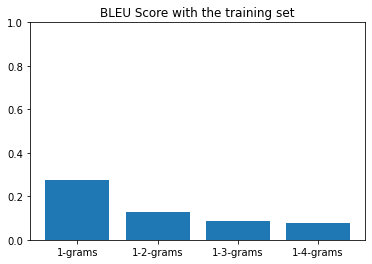

In [202]:
plt.bar(x = bleu_dic.keys(), height = bleu_dic.values())
plt.title("BLEU Score with the training set")
plt.ylim((0,1))
plt.show()

In [203]:
pip install rouge-score

  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for rouge-score: filename=rouge_score-0.1.2-py3-none-any.whl size=24955 sha256=dec96a56603f4b0d40191a21e798acd4863b6d206690908c9f402ad97bd37e27
  Stored in directory: c:\users\maheen.unzeela\appdata\local\pip\cache\wheels\b0\3f\ac\cc3bc304f50c77ef38d79d8e4e2684313de39af543cb4eb3da
Successfully built rouge-score
  Attempting uninstall: six
    Found existing installation: six 1.12.0
    Uninstalling six-1.12.0:
      Successfully uninstalled six-1.12.0
Note: you may need to restart the kernel to use updated packages.


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
conda-repo-cli 1.0.4 requires pathlib, which is not installed.
jupyter-server 1.13.5 requires pywinpty<2; os_name == "nt", but you have pywinpty 2.0.2 which is incompatible.
cookiecutter 1.7.3 requires requests>=2.23.0, but you have requests 2.21.0 which is incompatible.
botocore 1.24.32 requires urllib3<1.27,>=1.25.4, but you have urllib3 1.24.1 which is incompatible.


In [427]:
from rouge_score import rouge_scorer

scorer = rouge_scorer.RougeScorer(['rouge1', 'rougeL'], use_stemmer=True)
# scores = scorer.score('The quick brown fox jumps over the lazy dog',
#                       'The quick brown dog jumps on the log.')

In [211]:
# scores

In [215]:
for i,num in enumerate(randomlist):
    scores = scorer.score(summaried_article[i],
                      y_tr[num])
    print(scores)
    print('\n')

{'rouge1': Score(precision=0.03333333333333333, recall=0.06521739130434782, fmeasure=0.044117647058823525), 'rougeL': Score(precision=0.03333333333333333, recall=0.06521739130434782, fmeasure=0.044117647058823525)}


{'rouge1': Score(precision=0.2, recall=0.30985915492957744, fmeasure=0.24309392265193372), 'rougeL': Score(precision=0.13636363636363635, recall=0.2112676056338028, fmeasure=0.16574585635359115)}


{'rouge1': Score(precision=0.75, recall=0.8333333333333334, fmeasure=0.7894736842105262), 'rougeL': Score(precision=0.7125, recall=0.7916666666666666, fmeasure=0.75)}


{'rouge1': Score(precision=0.5, recall=0.23043478260869565, fmeasure=0.31547619047619047), 'rougeL': Score(precision=0.33962264150943394, recall=0.1565217391304348, fmeasure=0.21428571428571427)}


{'rouge1': Score(precision=0.1095890410958904, recall=0.11428571428571428, fmeasure=0.11188811188811189), 'rougeL': Score(precision=0.0958904109589041, recall=0.1, fmeasure=0.0979020979020979)}


{'rouge1': Score(preci

## BERT

In [502]:
from transformers import BertForQuestionAnswering
from transformers import BertTokenizer

In [503]:
model = BertForQuestionAnswering.from_pretrained('bert-large-uncased-whole-word-masking-finetuned-squad')

In [504]:
tokenizer = BertTokenizer.from_pretrained('bert-large-uncased-whole-word-masking-finetuned-squad')

In [220]:
def squad_json_to_dataframe_train(input_file_path, record_path = ['data','paragraphs','qas','answers'],
                           verbose = 1):
    """
    input_file_path: path to the squad json file.
    record_path: path to deepest level in json file default value is
    ['data','paragraphs','qas','answers']
    verbose: 0 to suppress it default is 1
    """
    if verbose:
        print("Reading the json file")    
    file = json.loads(open(input_file_path).read())
    if verbose:
        print("processing...")
    # parsing different level's in the json file
    js = pd.io.json.json_normalize(file , record_path )
    m = pd.io.json.json_normalize(file, record_path[:-1] )
    r = pd.io.json.json_normalize(file,record_path[:-2])
    
    #combining it into single dataframe
    idx = np.repeat(r['context'].values, r.qas.str.len())
    ndx  = np.repeat(m['id'].values,m['answers'].str.len())
    m['context'] = idx
    js['q_idx'] = ndx
    main = pd.concat([ m[['id','question','context']].set_index('id'),js.set_index('q_idx')],1,sort=False).reset_index()
    main['c_id'] = main['context'].factorize()[0]
    if verbose:
        print("shape of the dataframe is {}".format(main.shape))
        print("Done")
    return main

In [221]:
def squad_json_to_dataframe_dev(input_file_path, record_path = ['data','paragraphs','qas','answers'],
                           verbose = 1):
    """
    input_file_path: path to the squad json file.
    record_path: path to deepest level in json file default value is
    ['data','paragraphs','qas','answers']
    verbose: 0 to suppress it default is 1
    """
    if verbose:
        print("Reading the json file")    
    file = json.loads(open(input_file_path).read())
    if verbose:
        print("processing...")
    # parsing different level's in the json file
    js = pd.io.json.json_normalize(file , record_path )
    m = pd.io.json.json_normalize(file, record_path[:-1] )
    r = pd.io.json.json_normalize(file,record_path[:-2])
    
    #combining it into single dataframe
    idx = np.repeat(r['context'].values, r.qas.str.len())
#     ndx  = np.repeat(m['id'].values,m['answers'].str.len())
    m['context'] = idx
#     js['q_idx'] = ndx
    main = m[['id','question','context','answers']].set_index('id').reset_index()
    main['c_id'] = main['context'].factorize()[0]
    if verbose:
        print("shape of the dataframe is {}".format(main.shape))
        print("Done")
    return main

In [222]:
input_file_path = 'squad/train.json'
record_path = ['data','paragraphs','qas','answers']
train = squad_json_to_dataframe_train(input_file_path=input_file_path,record_path=record_path)

Reading the json file
processing...
shape of the dataframe is (130319, 6)
Done


In [223]:
train

,index,question,context,text,answer_start,c_id
0,56be85543aeaaa14008c9063,When did Beyonce start becoming popular?,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,in the late 1990s,269.0,0
1,56be85543aeaaa14008c9065,What areas did Beyonce compete in when she was...,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,singing and dancing,207.0,0
2,56be85543aeaaa14008c9066,When did Beyonce leave Destiny's Child and bec...,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,2003,526.0,0
3,56bf6b0f3aeaaa14008c9601,In what city and state did Beyonce grow up?,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,"Houston, Texas",166.0,0
4,56bf6b0f3aeaaa14008c9602,In which decade did Beyonce become famous?,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,late 1990s,276.0,0
...,...,...,...,...,...,...
130314,5a7e070b70df9f001a875439,Physics has broadly agreed on the definition o...,"The term ""matter"" is used throughout physics i...",NaN,NaN,19028
130315,5a7e070b70df9f001a87543a,Who coined the term partonic matter?,"The term ""matter"" is used throughout physics i...",NaN,NaN,19028
130316,5a7e070b70df9f001a87543b,What is another name for anti-matter?,"The term ""matter"" is used throughout physics i...",NaN,NaN,19028
130317,5a7e070b70df9f001a87543c,Matter usually does not need to be used in con...,"The term ""matter"" is used throughout physics i...",NaN,NaN,19028


In [264]:
pip install overrides

Note: you may need to restart the kernel to use updated packages.


In [266]:
pip install allennlp

^C
Note: you may need to restart the kernel to use updated packages.


In [646]:
def answer_question(question, answer_text):
    '''
    Takes a `question` string and an `answer_text` string (which contains the
    answer), and identifies the words within the `answer_text` that are the
    answer. Prints them out.
    '''
    # ======== Tokenize ========
    # Apply the tokenizer to the input text, treating them as a text-pair.
    input_ids = tokenizer.encode(question, answer_text)

    # Report how long the input sequence is.
    print('Query has {:,} tokens.\n'.format(len(input_ids)))

    # ======== Set Segment IDs ========
    # Search the input_ids for the first instance of the `[SEP]` token.
    sep_index = input_ids.index(tokenizer.sep_token_id)

    # The number of segment A tokens includes the [SEP] token istelf.
    num_seg_a = sep_index + 1

    # The remainder are segment B.
    num_seg_b = len(input_ids) - num_seg_a

    # Construct the list of 0s and 1s.
    segment_ids = [0]*num_seg_a + [1]*num_seg_b

    # There should be a segment_id for every input token.
    assert len(segment_ids) == len(input_ids)

    # ======== Evaluate ========
    # Run our example through the model.
    outputs = model(torch.tensor([input_ids]), # The tokens representing our input text.
                    token_type_ids=torch.tensor([segment_ids]), # The segment IDs to differentiate question from answer_text
                    return_dict=True) 

    start_scores = outputs.start_logits
    end_scores = outputs.end_logits

    # ======== Reconstruct Answer ========
    # Find the tokens with the highest `start` and `end` scores.
    answer_start = torch.argmax(start_scores)
    answer_end = torch.argmax(end_scores)

    # Get the string versions of the input tokens.
    tokens = tokenizer.convert_ids_to_tokens(input_ids)

    # Start with the first token.
    answer = tokens[answer_start]

    # Select the remaining answer tokens and join them with whitespace.
    for i in range(answer_start + 1, answer_end + 1):
        
        # If it's a subword token, then recombine it with the previous token.
        if tokens[i][0:2] == '##':
            answer += tokens[i][2:]
        
        # Otherwise, add a space then the token.
        else:
            answer += ' ' + tokens[i]

    print('Answer: "' + answer + '"')
    return answer

In [249]:
# pip install datasets

In [239]:
from datasets import load_dataset_builder
ds_builder = load_dataset_builder("allenai/qasper")

In [251]:
# ds_builder.info.features

In [492]:
from datasets import load_dataset

In [493]:
train_dataset = load_dataset("allenai/qasper",split="train")

In [494]:
train_dataset[0]

{'id': '1909.00694',
 'title': 'Minimally Supervised Learning of Affective Events Using Discourse Relations',
 'abstract': 'Recognizing affective events that trigger positive or negative sentiment has a wide range of natural language processing applications but remains a challenging problem mainly because the polarity of an event is not necessarily predictable from its constituent words. In this paper, we propose to propagate affective polarity using discourse relations. Our method is simple and only requires a very small seed lexicon and a large raw corpus. Our experiments using Japanese data show that our method learns affective events effectively without manually labeled data. It also improves supervised learning results when labeled data are small.',
 'full_text': {'section_name': ['Introduction',
   'Related Work',
   'Proposed Method',
   'Proposed Method ::: Polarity Function',
   'Proposed Method ::: Discourse Relation-Based Event Pairs',
   'Proposed Method ::: Discourse Relat

In [495]:
train_dataset[0]["qas"]['question']

['What is the seed lexicon?',
 'What are the results?',
 'How are relations used to propagate polarity?',
 'How big is the Japanese data?',
 'What are labels available in dataset for supervision?',
 'How big are improvements of supervszed learning results trained on smalled labeled data enhanced with proposed approach copared to basic approach?',
 'How does their model learn using mostly raw data?',
 'How big is seed lexicon used for training?',
 'How large is raw corpus used for training?']

In [496]:
train_dataset[0]["qas"]

{'question': ['What is the seed lexicon?',
  'What are the results?',
  'How are relations used to propagate polarity?',
  'How big is the Japanese data?',
  'What are labels available in dataset for supervision?',
  'How big are improvements of supervszed learning results trained on smalled labeled data enhanced with proposed approach copared to basic approach?',
  'How does their model learn using mostly raw data?',
  'How big is seed lexicon used for training?',
  'How large is raw corpus used for training?'],
 'question_id': ['753990d0b621d390ed58f20c4d9e4f065f0dc672',
  '9d578ddccc27dd849244d632dd0f6bf27348ad81',
  '02e4bf719b1a504e385c35c6186742e720bcb281',
  '44c4bd6decc86f1091b5fc0728873d9324cdde4e',
  '86abeff85f3db79cf87a8c993e5e5aa61226dc98',
  'c029deb7f99756d2669abad0a349d917428e9c12',
  '39f8db10d949c6b477fa4b51e7c184016505884f',
  'd0bc782961567dc1dd7e074b621a6d6be44bb5b4',
  'a592498ba2fac994cd6fad7372836f0adb37e22a'],
 'nlp_background': ['two',
  'two',
  'two',
  'two

In [497]:
train_dataset[0]["abstract"]

'Recognizing affective events that trigger positive or negative sentiment has a wide range of natural language processing applications but remains a challenging problem mainly because the polarity of an event is not necessarily predictable from its constituent words. In this paper, we propose to propagate affective polarity using discourse relations. Our method is simple and only requires a very small seed lexicon and a large raw corpus. Our experiments using Japanese data show that our method learns affective events effectively without manually labeled data. It also improves supervised learning results when labeled data are small.'

In [498]:
import textwrap

# Wrap text to 80 characters.
wrapper = textwrap.TextWrapper(width=80) 

abstract = train_dataset[0]["abstract"]

print(wrapper.fill(abstract))

Recognizing affective events that trigger positive or negative sentiment has a
wide range of natural language processing applications but remains a challenging
problem mainly because the polarity of an event is not necessarily predictable
from its constituent words. In this paper, we propose to propagate affective
polarity using discourse relations. Our method is simple and only requires a
very small seed lexicon and a large raw corpus. Our experiments using Japanese
data show that our method learns affective events effectively without manually
labeled data. It also improves supervised learning results when labeled data are
small.


In [505]:
question = "What is the seed lexicon?"

answer_question(question, abstract)

Query has 119 tokens.

Answer: "very small"


In [506]:

abstract = summ_df["abstracts"][0]

print(wrapper.fill(abstract))

Trigrams'n'Tags (TnT) is an efficient statistical part-of-speech tagger.
Contrary to claims found elsewhere in the literature, we argue that a tagger
based on Markov models performs at least as well as other current approaches,
including the Maximum Entropy framework. A recent comparison has even shown that
TnT performs significantly better for the tested corpora. We describe the basic
model of TnT, the techniques used for smoothing and for handling unknown words.
Furthermore, we present evaluations on two corpora.


In [507]:
question = "What is Trigrams'n'Tags?"

answer_question(question, abstract)

Query has 118 tokens.

Answer: "an efficient statistical part - of - speech tagger"


In [508]:
abstract = summ_df["text"][0]

print(wrapper.fill(abstract))

The sentences in the DSO collection were tagged with parts of speech using TnT
(Brants, 2000) trained on the Brown Corpus itself.  The English POS-tagging has
been carried out using freely available TNT tagger (Brants, 2000). This
proposition is quite viable as statistical POS taggers like TnT (Brants, 2000)
are available. We use TnT (Brants, 2000), a second order Markov Model tagger.
For PoS tagging and lemmatization, we combine GENIA (with its built-in,
occasionally deviant to kenizer) and TnT (Brants, 2000), which operates on pre-
tokenized inputs but in its default models trained on financial news from the
Penn Tree bank. Tag the tokens with PTB-style POS tags using a tagger (Brants,
2000). For example, Petrov et al (2012) build supervised POS taggers for 22
languages using the TNT tagger (Brants, 2000), with an average accuracy of
95.2%. Forun aligned words, we simply assign a random POS and very low
probability, which does not substantially affect transition probability
estimates

In [509]:
question = "What is Trigrams'n'Tags?"

answer_question(question, abstract)

Token indices sequence length is longer than the specified maximum sequence length for this model (1137 > 512). Running this sequence through the model will result in indexing errors


Query has 1,137 tokens.



RuntimeError: The size of tensor a (1137) must match the size of tensor b (512) at non-singleton dimension 1

In [511]:
tokens = tokenizer_pegasus(abstract, truncation=True, padding="longest", return_tensors="pt")
summary = model_pegasus.generate(**tokens)
dec_summ=tokenizer_pegasus.decode(summary[0]).replace('<pad>','').replace('</s>','')
# et = time.time()
# elapsed_time = et - st
# print(i," summarized",elapsed_time," seconds")

In [512]:
dec_summ

'the aim of this study was to investigate how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrated with automated tagger-based model of syntactic tree and how tagger-based model of lexical tree can be integrat

In [293]:
question = "What is aim of this study?"

answer_question(question, dec_summ)

Query has 295 tokens.

Answer: "to investigate how tagger - based model of lexical tree can be integrated with automated tagger - based model of syntactic tree"


## Extractive

In [4]:
def cos_dist(sent1,sent2):
    return 1-cosine_distance(sent1,sent2)

### TFIDF Vectorizer

In [5]:
def build_tfidf_similarity_matrix(sentences):
    #create an empty similarity matrix
    similarity_matrix = np.zeros((len(sentences),len(sentences)))
    vectorizer = TfidfVectorizer()
    X = vectorizer.fit_transform(sentences)
    X=X.toarray()
   
    for idx1 in range(len(sentences)):
        for idx2 in range(len(sentences)):
            if idx1!=idx2:
                similarity_matrix[idx1][idx2] = cos_dist(X[idx1],X[idx2])
                
    return similarity_matrix

### Count Vectorizer

In [6]:
def build_count_vector_similarity_matrix(sentences):
    #create an empty similarity matrix
    similarity_matrix = np.zeros((len(sentences),len(sentences)))
    count_vectorizer = CountVectorizer()
    X = count_vectorizer.fit_transform(sentences)
#     print(vectorizer.get_feature_names())
    X=X.toarray()
   

    for idx1 in range(len(sentences)):
        for idx2 in range(len(sentences)):
            if idx1!=idx2:
                similarity_matrix[idx1][idx2] = cos_dist(X[idx1],X[idx2])
                
    return similarity_matrix

In [7]:
import nltk
from nltk.corpus import stopwords
from nltk.cluster.util import cosine_distance
from nltk.tokenize import sent_tokenize
import numpy as np
import networkx as nx
import re



# Read the text and tokenize into sentences
def read_article(text):
    
    sentences =[]
    sentences = sent_tokenize(text)
#     print(sentences)
    
    for sentence in sentences:
        sentence.replace("[^a-zA-Z0-9]"," ")
    
    return sentences




# Generate and return text summary
def generate_summary(text,vector,top_n):

    summarize_text = []
    
    # Step1: read text and tokenize
    sentences = read_article(text)
    
    # Steo2: generate similarity matrix across sentences
    ## through tfidf vectors
    sentence_similarity_matrix = vector(sentences)
    
    
    # Step3: Rank sentences in similarirty matrix
    sentence_similarity_graph = nx.from_numpy_array(sentence_similarity_matrix)
    scores = nx.pagerank(sentence_similarity_graph)
#     print(scores,"scores")
    #Step4: sort the rank and place top sentences
    ranked_sentences = sorted(((scores[i],s) for i,s in enumerate(sentences)),reverse=True)
    another= [s for i,s in enumerate(sentences)]
#     print(another)
    # Step 5: get the top n number of sentences based on rank    
    for i in range(top_n):
        summarize_text.append(ranked_sentences[i][1])


    # Step 6 : outpur the summarized version
    return " ".join(summarize_text) ,scores,another

In [192]:
summ_tfidf,scores,another=generate_summary(summ_df["text"][0],build_tfidf_similarity_matrix,3)

In [193]:
scores

{0: 0.047143848096653104,
 1: 0.039922891467813776,
 2: 0.025176096672150997,
 3: 0.03271404315958309,
 4: 0.0381597362827053,
 5: 0.0388948288562109,
 6: 0.03845878937018822,
 7: 0.015491983146130284,
 8: 0.03885655104693107,
 9: 0.02358103859675643,
 10: 0.032773020831074695,
 11: 0.044363322970549374,
 12: 0.02424799606195986,
 13: 0.04450947184999331,
 14: 0.04114704070621508,
 15: 0.04024261685632802,
 16: 0.04655179083033231,
 17: 0.03193975840969154,
 18: 0.04584307632098861,
 19: 0.0339805599482487,
 20: 0.014672860918724375,
 21: 0.042813408065626266,
 22: 0.028643034816152914,
 23: 0.04116864725005563,
 24: 0.0239566839165408,
 25: 0.028283148472324212,
 26: 0.02734426560291086,
 27: 0.01940825195746442,
 28: 0.034401404632170604,
 29: 0.015309832887525202}

In [194]:
df=pd.DataFrame({"tfidf_scores":scores.values(),"sentences":another})

In [195]:
df

,tfidf_scores,sentences
0,0.047144,The sentences in the DSO collection were tagge...
1,0.039923,The English POS-tagging has been carried out u...
2,0.025176,This proposition is quite viable as statistica...
3,0.032714,"We use TnT (Brants, 2000), a second order Mark..."
4,0.038160,"For PoS tagging and lemmatization, we combine ..."
5,0.038895,Tag the tokens with PTB-style POS tags using a...
6,0.038459,"For example, Petrov et al (2012) build supervi..."
7,0.015492,"Forun aligned words, we simply assign a random..."
8,0.038857,In Step 6 we build a tagger by feeding the es ...
9,0.023581,based on tree-structures of various complexity...


In [218]:
summ_tfidf

'The sentences in the DSO collection were tagged with parts of speech using TnT (Brants, 2000) trained on the Brown Corpus itself. Because we want to make linguistically-informed corruptions, we corrupt only the words we have information for, identifying the words in the corpus which are found in the lexicon with the appropriate POS tag. To POS tag, we use the HMM tagger TnT (Brants, 2000) with the model from http: //corpus.leeds.ac.uk/mocky/.'

In [219]:
summ_count,scores,another=generate_summary(summ_df["text"][0],build_count_vector_similarity_matrix,3)

In [220]:
summ_count

'The sentences in the DSO collection were tagged with parts of speech using TnT (Brants, 2000) trained on the Brown Corpus itself. To POS tag, we use the HMM tagger TnT (Brants, 2000) with the model from http: //corpus.leeds.ac.uk/mocky/. We further plan to retrain state-of the-art POS taggers such as the TreeTagger and TnT Tagger (Brants, 2000b) on our data.'

In [221]:
df["count_scores"]=scores.values()

In [441]:
ind=df.nlargest(13,['tfidf_scores']).index.tolist()

In [442]:
ind2=df.nlargest(13,['count_scores']).index.tolist()

In [443]:
df['y']=0

In [444]:
for i in ind:
    df.at[i, 'y']=1
for j in ind2:
    df.at[j,'y']=1

In [445]:
df=shuffle(df)

In [446]:
df

,tfidf_scores,sentences,count_scores,y,result
2,0.025176,This proposition is quite viable as statistica...,0.015265,0,0.719599
28,0.034401,"We describe the basic model of TnT, the techni...",0.041481,1,0.118659
4,0.038160,"For PoS tagging and lemmatization, we combine ...",0.029916,0,0.613368
20,0.014673,"To make them useful, the necessary preprocessi...",0.045945,1,0.127124
18,0.045843,"To POS tag, we use the HMM tagger TnT (Brants,...",0.029577,1,0.128070
10,0.032773,"Using such tags, Brants (2000) has achieved th...",0.031689,0,0.692703
24,0.023957,"Finally, we plan to investigate how linguistic...",0.022692,0,0.697012
11,0.044363,"We also incorporated part-of speech tagging, u...",0.041513,1,0.106159
21,0.042813,The texts were first automatically segmented a...,0.018199,1,0.155926
25,0.028283,Trigrams'n'Tags (TnT) is an efficient statisti...,0.033544,0,0.647853


In [447]:
x_train, x_test, y_train, y_test = train_test_split(df.drop(['y','sentences'],axis=1), df['y'], test_size=0.2, random_state=321)

In [448]:
# x_train_array = np.array(x_train).reshape(-1,1)
logistic = LogisticRegression() 
model = logistic.fit(x_train, y_train)

In [449]:
y_predict_prob=model.predict_proba(x_test)

In [450]:
y_predict_prob

array([[0.24561824, 0.75438176],
       [0.53510322, 0.46489678],
       [0.24202878, 0.75797122],
       [0.25424446, 0.74575554],
       [0.24226121, 0.75773879],
       [0.31503577, 0.68496423]])

In [451]:
y_predict_prob_class_1 = y_predict_prob[:,1]

In [452]:
y_predict_class = [1 if prob > 0.3 else 0 for prob in y_predict_prob_class_1]

In [453]:
print("Accuracy:", round(accuracy_score(y_test, y_predict_class), 3))

Accuracy: 0.833


In [454]:
y_test

26    1
2     0
7     1
23    1
16    1
6     1
Name: y, dtype: int64

In [455]:
y_predict_class

[1, 1, 1, 1, 1, 1]

In [456]:
model_1 = LogisticRegression()
model_2 = RandomForestClassifier()

In [457]:
final_model = VotingClassifier(
    estimators=[('lr', model_1), ('rf', model_2)], voting='soft')
 
# training all the model on the train dataset
final_model.fit(x_train, y_train)
 
# predicting the output on the test dataset
pred_final = final_model.predict(x_test)
print(pred_final)
# printing log loss between actual and predicted value
print(log_loss(y_test, pred_final))

[1 0 1 1 1 1]
9.992007221626415e-16


In [458]:
len(final_model.predict_proba(df.drop(['y','sentences'],axis=1)))

30

In [459]:
result=final_model.predict_proba(df.drop(['y','sentences'],axis=1))[:, 0]

In [460]:
df["result"]=result

In [461]:
df

,tfidf_scores,sentences,count_scores,y,result
2,0.025176,This proposition is quite viable as statistica...,0.015265,0,0.727552
28,0.034401,"We describe the basic model of TnT, the techni...",0.041481,1,0.126393
4,0.038160,"For PoS tagging and lemmatization, we combine ...",0.029916,0,0.649256
20,0.014673,"To make them useful, the necessary preprocessi...",0.045945,1,0.148101
18,0.045843,"To POS tag, we use the HMM tagger TnT (Brants,...",0.029577,1,0.143242
10,0.032773,"Using such tags, Brants (2000) has achieved th...",0.031689,0,0.755331
24,0.023957,"Finally, we plan to investigate how linguistic...",0.022692,0,0.756547
11,0.044363,"We also incorporated part-of speech tagging, u...",0.041513,1,0.118938
21,0.042813,The texts were first automatically segmented a...,0.018199,1,0.148867
25,0.028283,Trigrams'n'Tags (TnT) is an efficient statisti...,0.033544,0,0.733435


In [462]:
sum_ensemble=" ".join(df.nlargest(5,['result'])["sentences"])

In [463]:
sum_ensemble

'Finally, we plan to investigate how linguistic annotations can be automatically integrated in the TEI annotated version of the corpus to produce TEI con formant output. We use TnT (Brants, 2000), a second order Markov Model tagger. Using such tags, Brants (2000) has achieved the automated tagging of a syntactic-structure-based set of grammatical function tags including phrase-chunk and syntactic-role modifiers trained in supervised mode from a tree bank of German. Furthermore, we present evaluations on two corpora. A recent comparison has even shown that TnT performs significantly better for the tested corpora.'

## Evaluation

#### From tfidf

In [374]:
ext_cand_tfidf=summ_tfidf

In [375]:
ext_cand_tfidf=ext_cand_tfidf.split(' ')

In [376]:
reference=[summ_df["summaries"][0]]

In [377]:
reference

["TnT - A Statistical Part-Of-Speech Tagger\nTrigrams'n'Tags (TnT) is an efficient statistical part-of-speech tagger.\nContrary to claims found elsewhere in the literature, we argue that a tagger based on Markov models performs at least as well as other current approaches, including the Maximum Entropy framework.\nA recent comparison has even shown that TnT performs significantly better for the tested corpora.\nWe describe the basic model of TnT, the techniques used for smoothing and for handling unknown words.\nFurthermore, we present evaluations on two corpora.\nWe achieve the automated tagging of a syntactic-structure-based set of grammatical function tags including phrase-chunk and syntactic-role modifiers trained in supervised mode from a tree bank of German.\n"]

In [378]:
reference=[summ_df["summaries"][0].split(' ')]

In [379]:
reference[0]

['TnT',
 '-',
 'A',
 'Statistical',
 'Part-Of-Speech',
 "Tagger\nTrigrams'n'Tags",
 '(TnT)',
 'is',
 'an',
 'efficient',
 'statistical',
 'part-of-speech',
 'tagger.\nContrary',
 'to',
 'claims',
 'found',
 'elsewhere',
 'in',
 'the',
 'literature,',
 'we',
 'argue',
 'that',
 'a',
 'tagger',
 'based',
 'on',
 'Markov',
 'models',
 'performs',
 'at',
 'least',
 'as',
 'well',
 'as',
 'other',
 'current',
 'approaches,',
 'including',
 'the',
 'Maximum',
 'Entropy',
 'framework.\nA',
 'recent',
 'comparison',
 'has',
 'even',
 'shown',
 'that',
 'TnT',
 'performs',
 'significantly',
 'better',
 'for',
 'the',
 'tested',
 'corpora.\nWe',
 'describe',
 'the',
 'basic',
 'model',
 'of',
 'TnT,',
 'the',
 'techniques',
 'used',
 'for',
 'smoothing',
 'and',
 'for',
 'handling',
 'unknown',
 'words.\nFurthermore,',
 'we',
 'present',
 'evaluations',
 'on',
 'two',
 'corpora.\nWe',
 'achieve',
 'the',
 'automated',
 'tagging',
 'of',
 'a',
 'syntactic-structure-based',
 'set',
 'of',
 'gramma

In [380]:
bleu_dic={}

In [381]:
def bleu(cand):# score = sentence_bleu(reference[i], candidate[i], weights=(1, 0, 0, 0))
    bleu_dic['1-grams'] = sentence_bleu([reference[0]], cand, weights=(1, 0, 0, 0))
    bleu_dic['1-2-grams'] = sentence_bleu([reference[0]], cand, weights=(0, 1, 0, 0))
    bleu_dic['1-3-grams'] = sentence_bleu([reference[0]], cand, weights=(0, 0, 1, 0))
    bleu_dic['1-4-grams'] = sentence_bleu([reference[0]], cand, weights=(0, 0, 0, 1))

In [382]:
bleu(ext_cand_tfidf)

In [383]:
bleu_dic

{'1-grams': 0.17322636567393696,
 '1-2-grams': 0.008783308682058776,
 '1-3-grams': 1.387589248315069e-308,
 '1-4-grams': 1.387589248315069e-308}

In [384]:
def show_bleu_bar(met):
    plt.bar(x = bleu_dic.keys(), height = bleu_dic.values())
    plt.title("BLEU Score with the " + met+ " set")
    plt.ylim((0,1))
    plt.show()

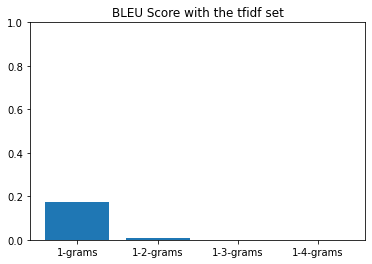

In [385]:
show_bleu_bar("tfidf")

#### From count

In [386]:
ext_cand_count=summ_count

In [387]:
bleu(ext_cand_count)

In [388]:
bleu_dic

{'1-grams': 0.011111111111111112,
 '1-2-grams': 2.2250738585072626e-308,
 '1-3-grams': 2.2250738585072626e-308,
 '1-4-grams': 2.2250738585072626e-308}

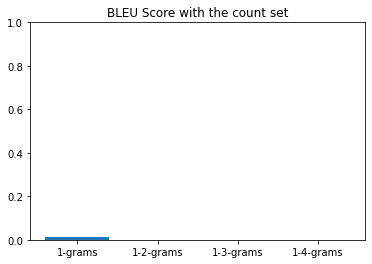

In [389]:
show_bleu_bar("count")

#### Ensemble

In [464]:
ext_cand_ensem=sum_ensemble

In [465]:
bleu(ext_cand_ensem)

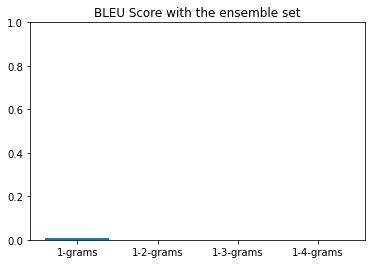

In [466]:
show_bleu_bar("ensemble")

In [467]:
bleu_dic

{'1-grams': 0.00809061488673139,
 '1-2-grams': 2.2250738585072626e-308,
 '1-3-grams': 2.2250738585072626e-308,
 '1-4-grams': 2.2250738585072626e-308}

In [428]:
rouge_ref=summ_df["summaries"][0]

In [429]:
rouge_ref

"TnT - A Statistical Part-Of-Speech Tagger\nTrigrams'n'Tags (TnT) is an efficient statistical part-of-speech tagger.\nContrary to claims found elsewhere in the literature, we argue that a tagger based on Markov models performs at least as well as other current approaches, including the Maximum Entropy framework.\nA recent comparison has even shown that TnT performs significantly better for the tested corpora.\nWe describe the basic model of TnT, the techniques used for smoothing and for handling unknown words.\nFurthermore, we present evaluations on two corpora.\nWe achieve the automated tagging of a syntactic-structure-based set of grammatical function tags including phrase-chunk and syntactic-role modifiers trained in supervised mode from a tree bank of German.\n"

In [437]:
def rouge_scores_func(summariz):
     scores = scorer.score(summariz,
                      rouge_ref)
     print(scores)


In [438]:
rouge_scores_func(summ_tfidf)

{'rouge1': Score(precision=0.24793388429752067, recall=0.38961038961038963, fmeasure=0.30303030303030304), 'rougeL': Score(precision=0.12396694214876033, recall=0.19480519480519481, fmeasure=0.15151515151515152)}


In [468]:
rouge_scores_func(sum_ensemble)

{'rouge1': Score(precision=0.5537190082644629, recall=0.6979166666666666, fmeasure=0.6175115207373272), 'rougeL': Score(precision=0.32231404958677684, recall=0.40625, fmeasure=0.3594470046082949)}


In [513]:
rouge_scores_func(dec_summ)

{'rouge1': Score(precision=0.17355371900826447, recall=0.0995260663507109, fmeasure=0.12650602409638556), 'rougeL': Score(precision=0.15702479338842976, recall=0.09004739336492891, fmeasure=0.11445783132530121)}


### Question Ans

In [695]:
abstract_qasper=train_dataset[1]['abstract']

In [696]:
ques=train_dataset[1]['qas']['question']

In [697]:
len_ques=len(ques)

In [700]:
train_dataset[1]['qas']['answers'][1]["answer"]

[{'unanswerable': False,
  'extractive_spans': ['confusion matrices of labels between annotators'],
  'yes_no': None,
  'free_form_answer': '',
  'evidence': ['We find that Cohen $\\kappa $ agreement ranges from .84 for Uneasiness in the English data, .81 for Humor and Nostalgia, down to German Suspense (.65), Awe/Sublime (.61) and Vitality for both languages (.50 English, .63 German). Both annotators have a similar emotion frequency profile, where the ranking is almost identical, especially for German. However, for English, Annotator 2 annotates more Vitality than Uneasiness. Figure FIGREF18 shows the confusion matrices of labels between annotators as heatmaps. Notably, Beauty/Joy and Sadness are confused across annotators more often than other labels. This is topical for poetry, and therefore not surprising: One might argue that the beauty of beings and situations is only beautiful because it is not enduring and therefore not to divorce from the sadness of the vanishing of beauty BIB

In [704]:
for ans in range(0,len_ques):
     ans_len=len(train_dataset[1]['qas']['answers'][ans]["answer"])
     globals()[f"ans_{ans}"] =[]
     for an in range(0,ans_len):
            globals()[f"ans_{ans}"].append(train_dataset[1]['qas']['answers'][ans]["answer"][an]['evidence'][0])
           
            

In [705]:
ans_2

["To emotionally move readers is considered a prime goal of literature since Latin antiquity BIBREF1, BIBREF2, BIBREF3. Deeply moved readers shed tears or get chills and goosebumps even in lab settings BIBREF4. In cases like these, the emotional response actually implies an aesthetic evaluation: narratives that have the capacity to move readers are evaluated as good and powerful texts for this very reason. Similarly, feelings of suspense experienced in narratives not only respond to the trajectory of the plot's content, but are also directly predictive of aesthetic liking (or disliking). Emotions that exhibit this dual capacity have been defined as “aesthetic emotions” BIBREF2. Contrary to the negativity bias of classical emotion catalogues, emotion terms used for aesthetic evaluation purposes include far more positive than negative emotions. At the same time, many overall positive aesthetic emotions encompass negative or mixed emotional ingredients BIBREF2, e.g., feelings of suspense 

In [625]:
# print(train_dataset[0]['qas']['answers'][1])

In [626]:
import textwrap

# Wrap text to 80 characters.
wrapper = textwrap.TextWrapper(width=80) 

# abstract = abstract_qasper

print(wrapper.fill(abstract_qasper))

Most approaches to emotion analysis regarding social media, literature, news,
and other domains focus exclusively on basic emotion categories as defined by
Ekman or Plutchik. However, art (such as literature) enables engagement in a
broader range of more complex and subtle emotions that have been shown to also
include mixed emotional responses. We consider emotions as they are elicited in
the reader, rather than what is expressed in the text or intended by the author.
Thus, we conceptualize a set of aesthetic emotions that are predictive of
aesthetic appreciation in the reader, and allow the annotation of multiple
labels per line to capture mixed emotions within context. We evaluate this novel
setting in an annotation experiment both with carefully trained experts and via
crowdsourcing. Our annotation with experts leads to an acceptable agreement of
kappa=.70, resulting in a consistent dataset for future large scale analysis.
Finally, we conduct first emotion classification experiments

 ### QA as Evaluation for summary

In [658]:
question = ques[2]
print(question)


What are the aesthetic emotions formalized?


In [659]:
ans_2

["To emotionally move readers is considered a prime goal of literature since Latin antiquity BIBREF1, BIBREF2, BIBREF3. Deeply moved readers shed tears or get chills and goosebumps even in lab settings BIBREF4. In cases like these, the emotional response actually implies an aesthetic evaluation: narratives that have the capacity to move readers are evaluated as good and powerful texts for this very reason. Similarly, feelings of suspense experienced in narratives not only respond to the trajectory of the plot's content, but are also directly predictive of aesthetic liking (or disliking). Emotions that exhibit this dual capacity have been defined as “aesthetic emotions” BIBREF2. Contrary to the negativity bias of classical emotion catalogues, emotion terms used for aesthetic evaluation purposes include far more positive than negative emotions. At the same time, many overall positive aesthetic emotions encompass negative or mixed emotional ingredients BIBREF2, e.g., feelings of suspense 

In [660]:
summ_tfidf,scores,another=generate_summary(abstract_qasper,build_tfidf_similarity_matrix,3)

In [661]:
summ_tfidf

'Thus, we conceptualize a set of aesthetic emotions that are predictive of aesthetic appreciation in the reader, and allow the annotation of multiple labels per line to capture mixed emotions within context. Finally, we conduct first emotion classification experiments based on BERT, showing that identifying aesthetic emotions is challenging in our data, with up to .52 F1-micro on the German subset. We consider emotions as they are elicited in the reader, rather than what is expressed in the text or intended by the author.'

In [662]:
pred=answer_question(question, summ_tfidf)

Query has 113 tokens.

Answer: "predictive of aesthetic appreciation in the reader"


In [663]:
rouge_ref_qa=ans_2[0]

In [664]:
rouge_scores_func(pred)

{'rouge1': Score(precision=0.024793388429752067, recall=0.42857142857142855, fmeasure=0.04687500000000001), 'rougeL': Score(precision=0.024793388429752067, recall=0.42857142857142855, fmeasure=0.04687500000000001)}


In [671]:
train_dataset[0]['qas']['answers'][0]["answer"]

[{'unanswerable': False,
  'extractive_spans': [],
  'yes_no': None,
  'free_form_answer': 'a vocabulary of positive and negative predicates that helps determine the polarity score of an event',
  'evidence': ['The seed lexicon consists of positive and negative predicates. If the predicate of an extracted event is in the seed lexicon and does not involve complex phenomena like negation, we assign the corresponding polarity score ($+1$ for positive events and $-1$ for negative events) to the event. We expect the model to automatically learn complex phenomena through label propagation. Based on the availability of scores and the types of discourse relations, we classify the extracted event pairs into the following three types.'],
  'highlighted_evidence': ['The seed lexicon consists of positive and negative predicates. If the predicate of an extracted event is in the seed lexicon and does not involve complex phenomena like negation, we assign the corresponding polarity score ($+1$ for po

In [761]:
abstract_qasper0=train_dataset[0]['abstract']
ques=train_dataset[0]['qas']['question']
len_ques=len(ques)
train_dataset[0]['qas']['answers'][ans]["answer"]
for ans in range(0,len_ques):
     ans_len=len(train_dataset[0]['qas']['answers'][ans]["answer"])
     globals()[f"ans_{ans}"] =[]
     for an in range(0,ans_len):
            globals()[f"ans_{ans}"].append(train_dataset[0]['qas']['answers'][ans]["answer"][an]['evidence'][0])

In [707]:
abstract_qasper0

'Recognizing affective events that trigger positive or negative sentiment has a wide range of natural language processing applications but remains a challenging problem mainly because the polarity of an event is not necessarily predictable from its constituent words. In this paper, we propose to propagate affective polarity using discourse relations. Our method is simple and only requires a very small seed lexicon and a large raw corpus. Our experiments using Japanese data show that our method learns affective events effectively without manually labeled data. It also improves supervised learning results when labeled data are small.'

In [758]:
# summ_tfidf,scores,another=generate_summary(abstract_qasper0,build_tfidf_similarity_matrix,3)

In [759]:
# question = ques[1]
# print(question)
# pred=answer_question(question, summ_tfidf)

In [760]:
# ans_1

In [711]:
tokens = tokenizer_pegasus(abstract_qasper0, truncation=True, padding="longest", return_tensors="pt")
summary = model_pegasus.generate(**tokens)
dec_summ=tokenizer_pegasus.decode(summary[0]).replace('<pad>','').replace('</s>','')

In [762]:
question = ques[1]
print(question)
pred=answer_question(question, dec_summ)

What are the results?
Query has 104 tokens.

Answer: "improves supervised results when labeled data are small"


In [763]:
ans_1[0]

'FLOAT SELECTED: Table 3: Performance of various models on the ACP test set.'

In [764]:
rouge_ref_qa=ans_1[0]

In [765]:
pred

'improves supervised results when labeled data are small'

In [766]:
rouge_scores_func(pred)

{'rouge1': Score(precision=0.008264462809917356, recall=0.125, fmeasure=0.015503875968992248), 'rougeL': Score(precision=0.008264462809917356, recall=0.125, fmeasure=0.015503875968992248)}
